# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

import os
os.environ["CUDA_VISIBLE_DEVICES"] = "3"
def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [4]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [5]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [6]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [31]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), dim=1)
    combined = combined.float()
    #### END CODE HERE ####
    return combined

In [32]:
assert tuple(combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5)).shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [9]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [13]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [16]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [17]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [18]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.150376093387604, discriminator loss: 0.2417040666528046


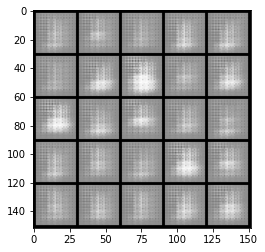

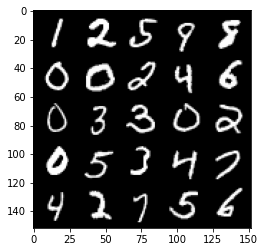

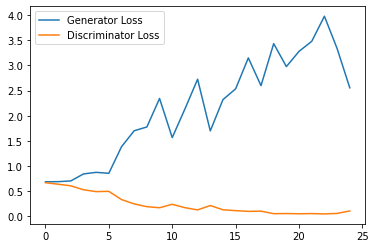

Step 1000: Generator loss: 4.377518390178681, discriminator loss: 0.03735540149081498


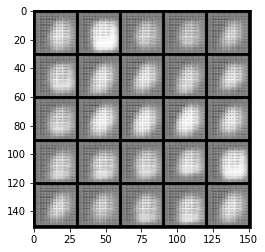

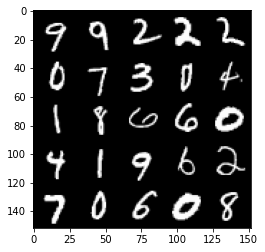

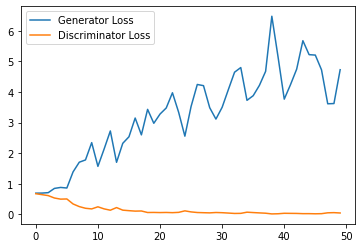

Step 1500: Generator loss: 5.452376557350159, discriminator loss: 0.02660686362348497


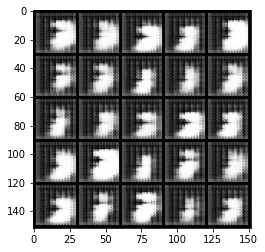

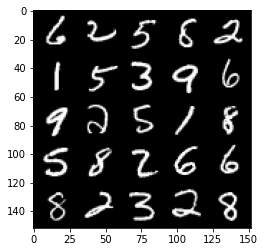

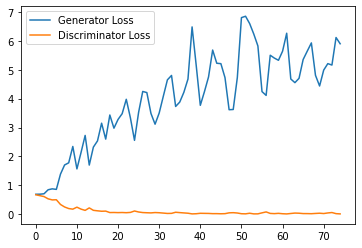

Step 2000: Generator loss: 4.70389379119873, discriminator loss: 0.059951629572547974


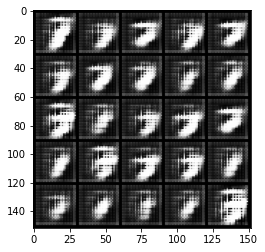

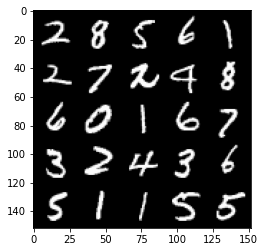

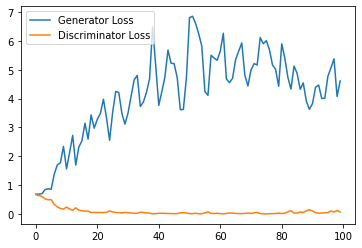

Step 2500: Generator loss: 4.4825396485328675, discriminator loss: 0.051020602103322744


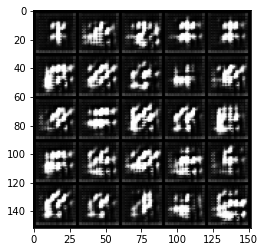

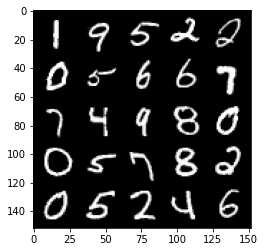

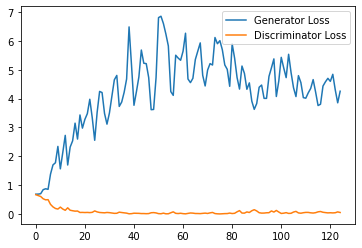

Step 3000: Generator loss: 3.6297285985946655, discriminator loss: 0.12731831099838017


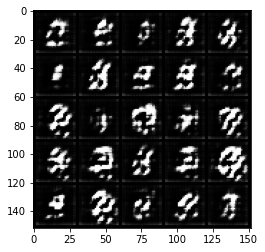

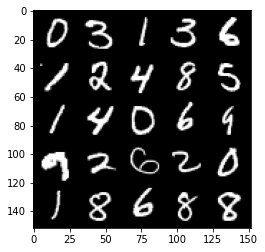

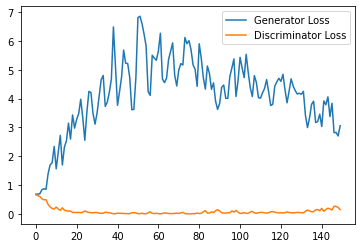

Step 3500: Generator loss: 2.7217128648757933, discriminator loss: 0.25050602093338964


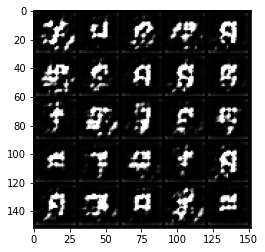

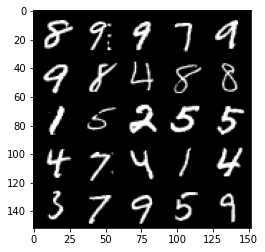

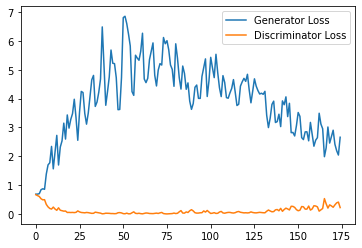

Step 4000: Generator loss: 2.3646115212440493, discriminator loss: 0.2992647029161453


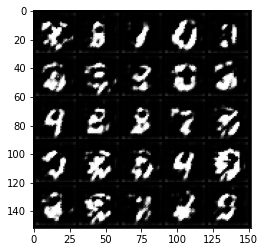

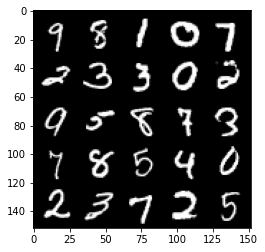

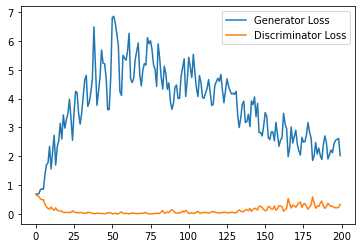

Step 4500: Generator loss: 2.236156587600708, discriminator loss: 0.3001821476817131


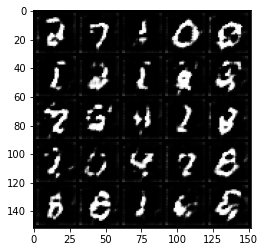

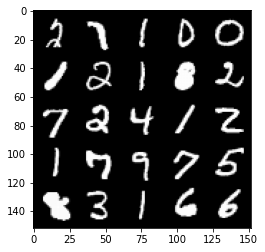

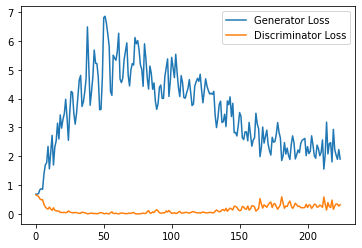

Step 5000: Generator loss: 2.0568262975215914, discriminator loss: 0.31650419160723686


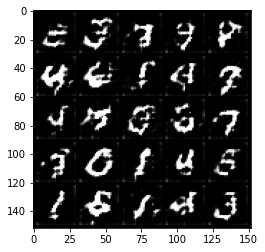

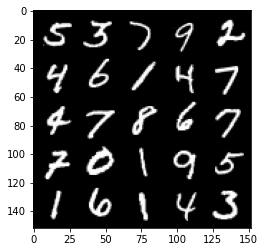

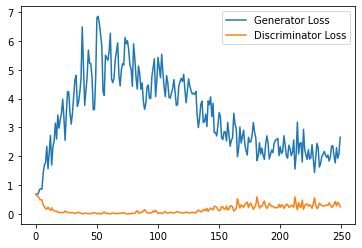

Step 5500: Generator loss: 2.198170892238617, discriminator loss: 0.31069952139258383


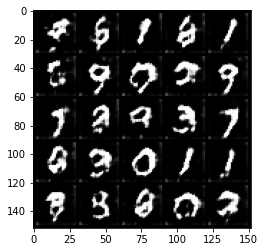

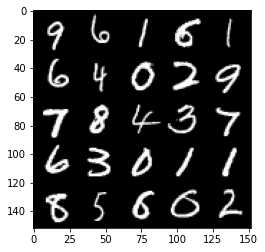

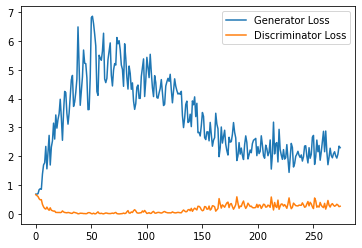

Step 6000: Generator loss: 1.9868070429563522, discriminator loss: 0.33245725437998774


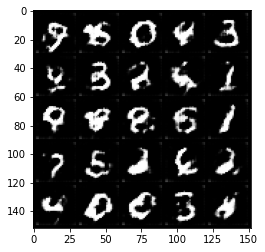

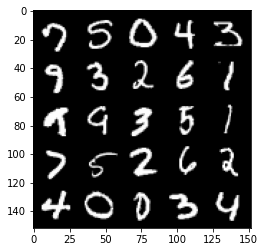

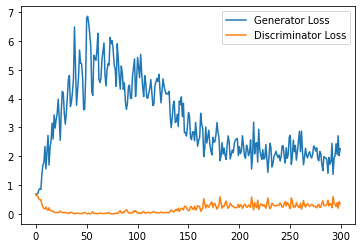

Step 6500: Generator loss: 1.8041177172660827, discriminator loss: 0.3829678824841976


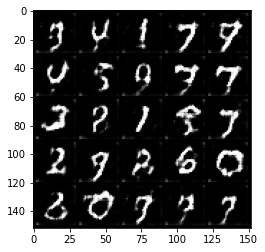

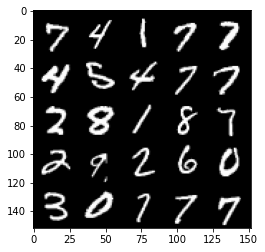

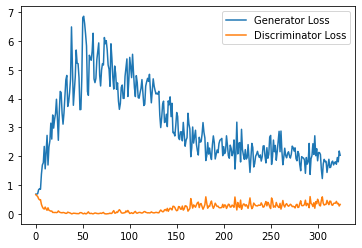

Step 7000: Generator loss: 1.7446894268989563, discriminator loss: 0.40606691321730615


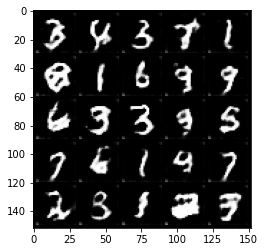

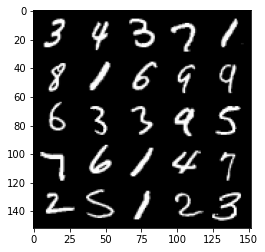

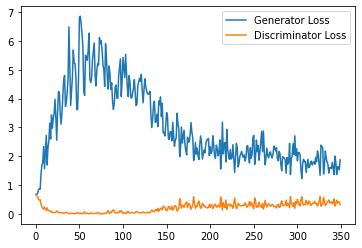

Step 7500: Generator loss: 1.6276786861419679, discriminator loss: 0.417355837225914


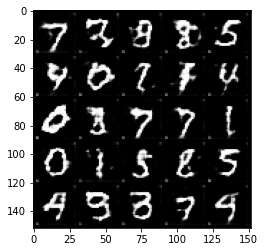

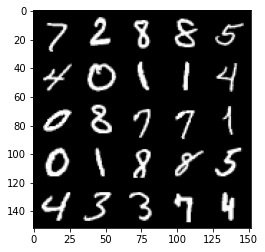

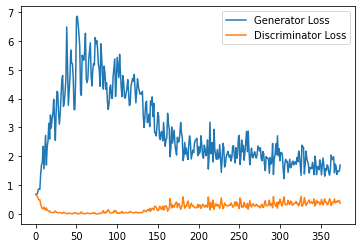

Step 8000: Generator loss: 1.6001211689710617, discriminator loss: 0.4431816022992134


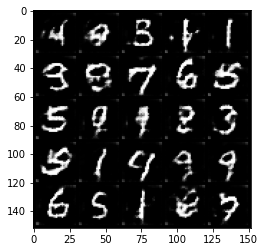

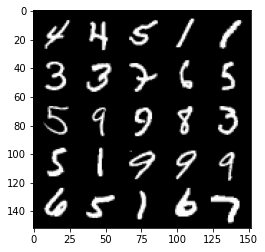

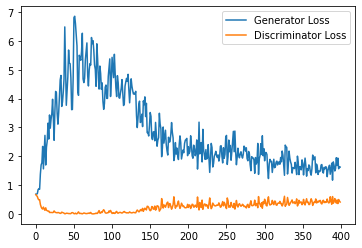

Step 8500: Generator loss: 1.5933861137628555, discriminator loss: 0.44631548690795897


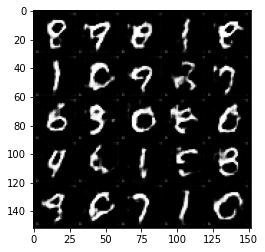

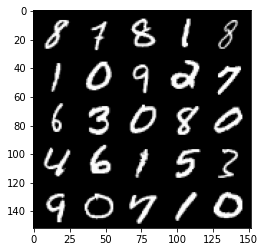

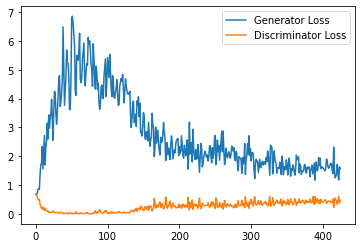

Step 9000: Generator loss: 1.5032503739595413, discriminator loss: 0.49520004749298097


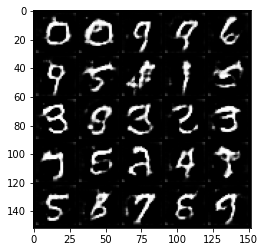

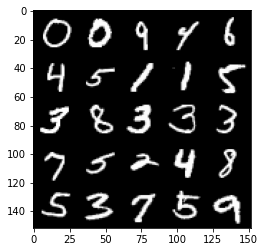

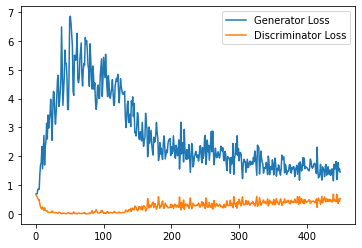

Step 9500: Generator loss: 1.396652272582054, discriminator loss: 0.49177531439065936


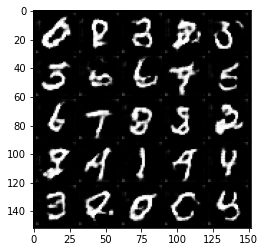

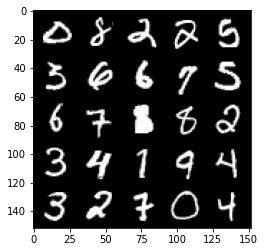

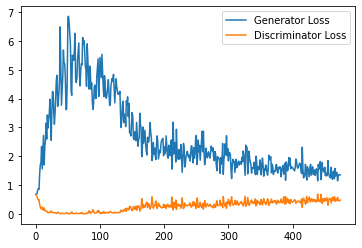

Step 10000: Generator loss: 1.3370823615789413, discriminator loss: 0.5061795848011971


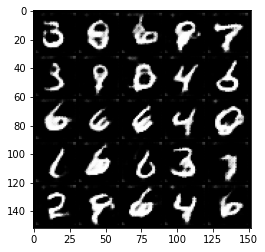

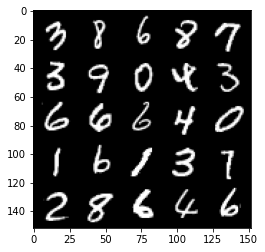

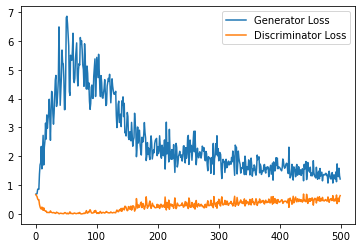

Step 10500: Generator loss: 1.3493747882843017, discriminator loss: 0.518885497033596


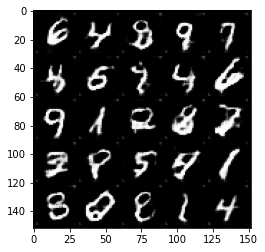

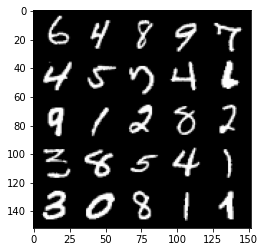

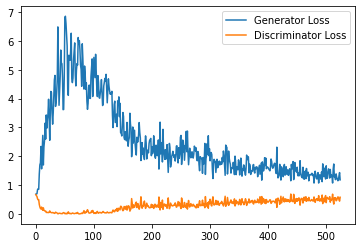

Step 11000: Generator loss: 1.2256180911064147, discriminator loss: 0.5333228403329849


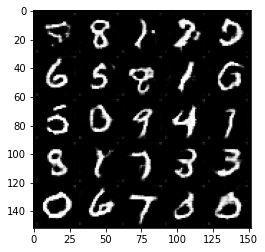

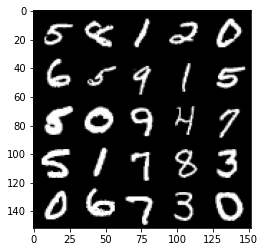

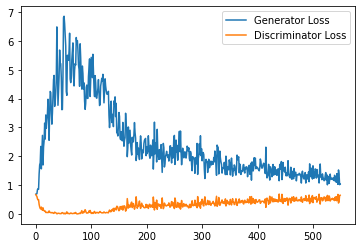

Step 11500: Generator loss: 1.250126124739647, discriminator loss: 0.5480982480049134


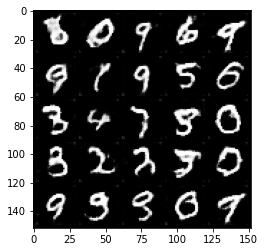

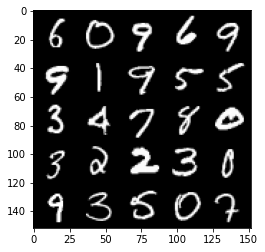

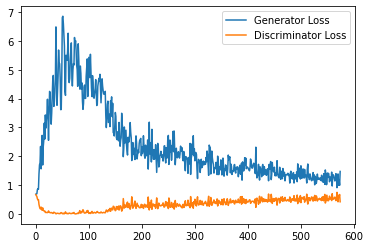

Step 12000: Generator loss: 1.2186701452732087, discriminator loss: 0.5458719056844711


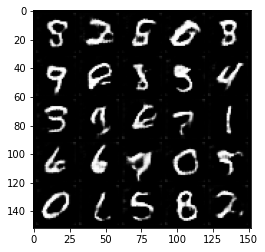

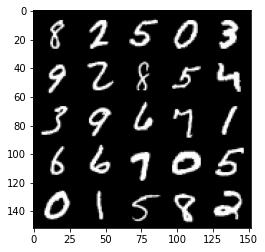

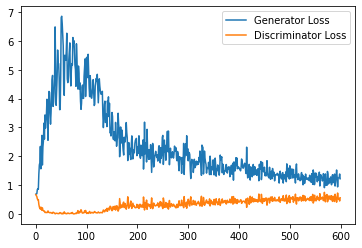

Step 12500: Generator loss: 1.1964862635135651, discriminator loss: 0.5470424876213074


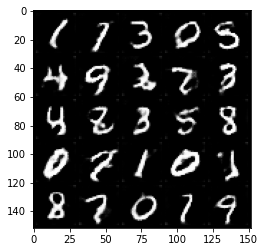

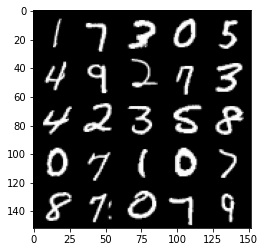

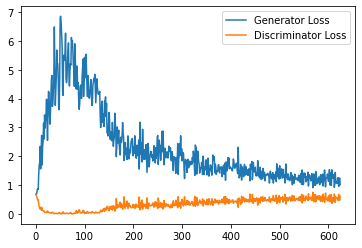

Step 13000: Generator loss: 1.2042763353586197, discriminator loss: 0.5650944728255272


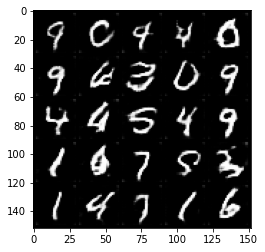

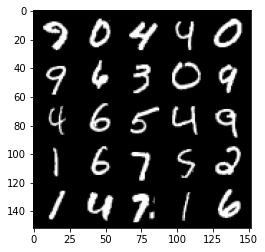

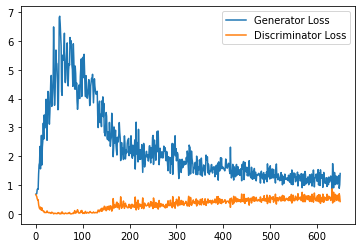

Step 13500: Generator loss: 1.1248580348491668, discriminator loss: 0.5667278317809105


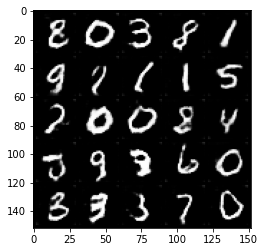

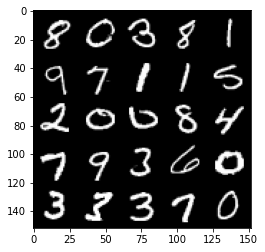

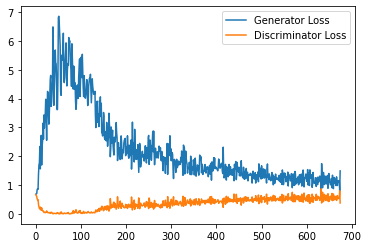

Step 14000: Generator loss: 1.0898812240362168, discriminator loss: 0.5777607718110085


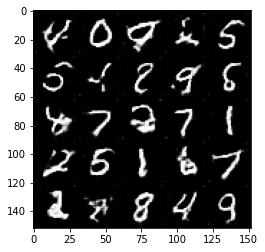

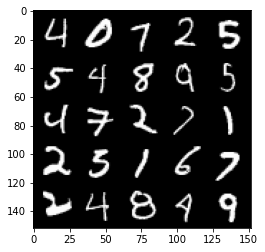

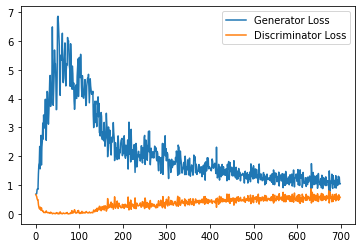

Step 14500: Generator loss: 1.0932313845157624, discriminator loss: 0.5803530865311622


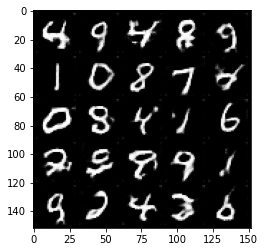

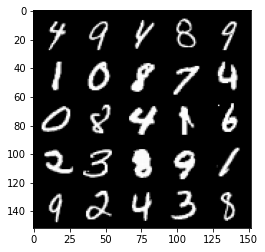

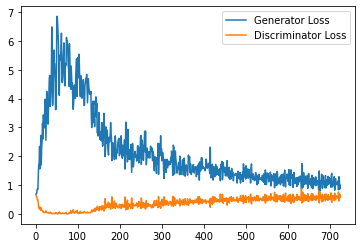

Step 15000: Generator loss: 1.0940469913482667, discriminator loss: 0.5809906330108643


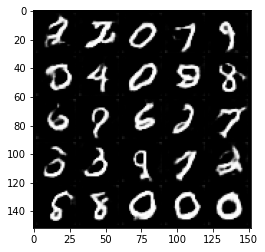

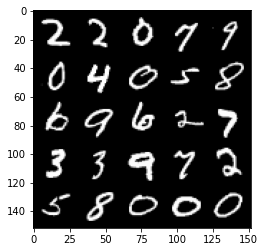

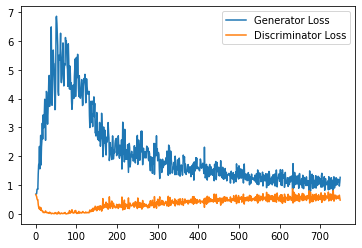

Step 15500: Generator loss: 1.0822690740823746, discriminator loss: 0.5923490326404571


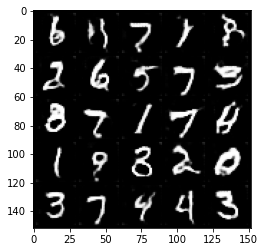

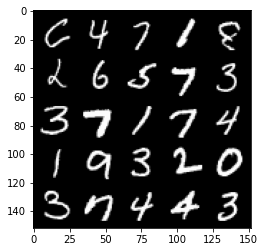

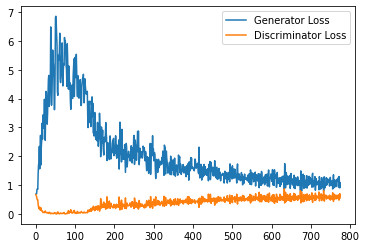

Step 16000: Generator loss: 1.0735164488554, discriminator loss: 0.5984755699038505


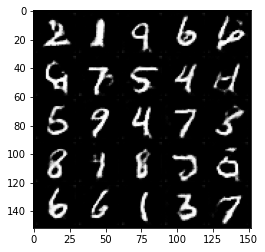

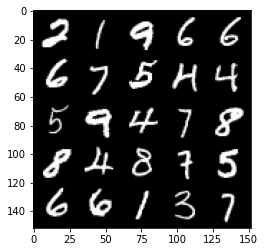

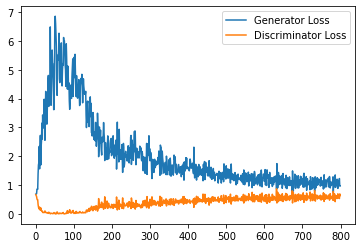

Step 16500: Generator loss: 1.0977129579782485, discriminator loss: 0.5937712882757187


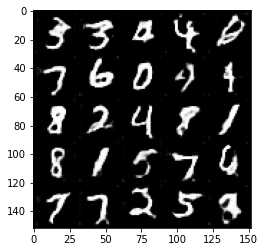

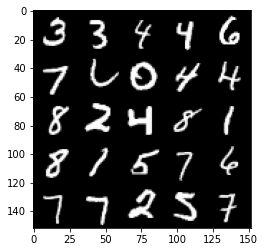

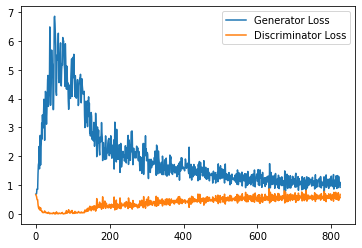

Step 17000: Generator loss: 1.0388046516180038, discriminator loss: 0.6004652835130692


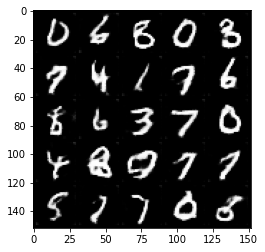

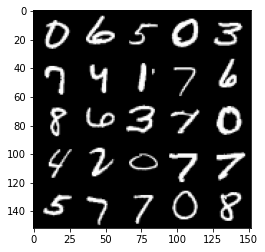

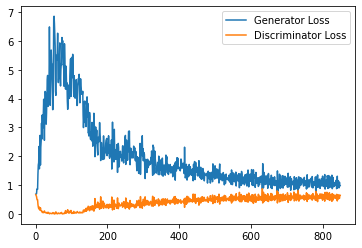

Step 17500: Generator loss: 1.0213196468353272, discriminator loss: 0.6011048524379731


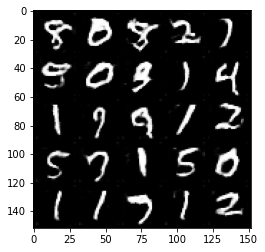

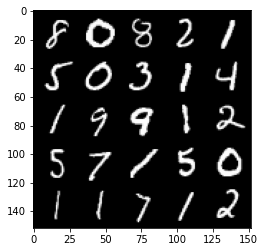

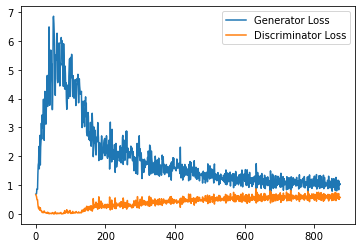

Step 18000: Generator loss: 1.0581997810602188, discriminator loss: 0.6057867419123649


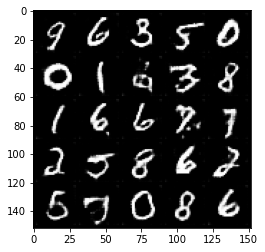

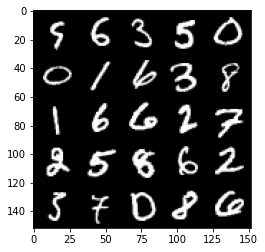

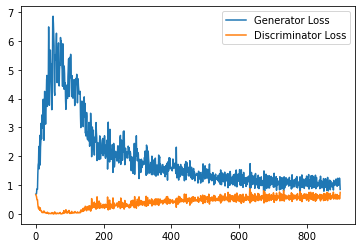

Step 18500: Generator loss: 1.040766763329506, discriminator loss: 0.6076581375598907


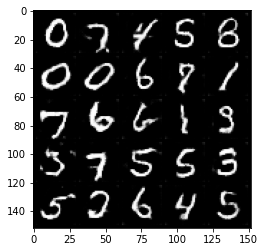

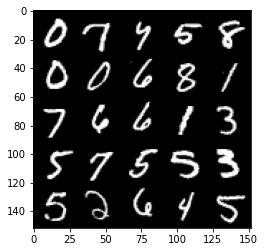

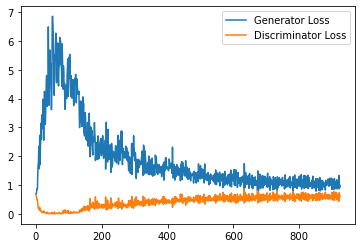

Step 19000: Generator loss: 0.9835631753206253, discriminator loss: 0.6046505578756333


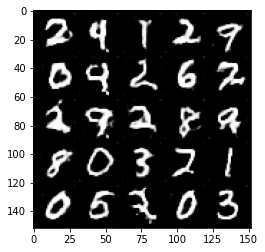

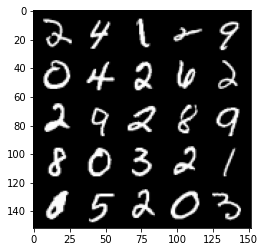

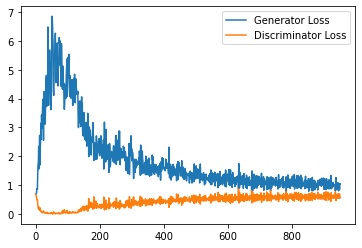

Step 19500: Generator loss: 0.958961853146553, discriminator loss: 0.6124533087611198


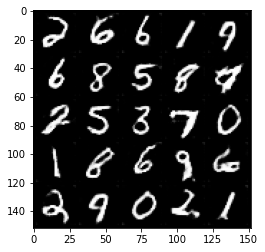

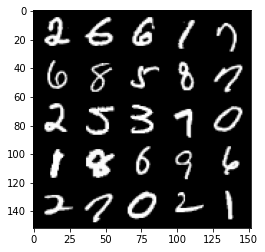

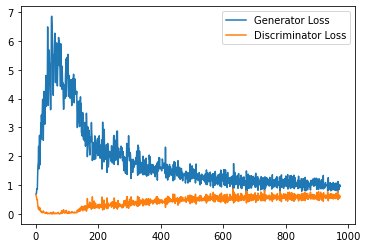

Step 20000: Generator loss: 0.9915222194194794, discriminator loss: 0.6091504718661308


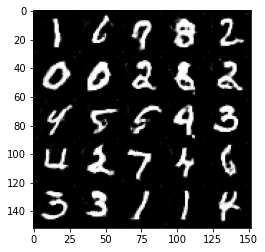

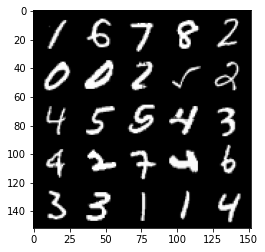

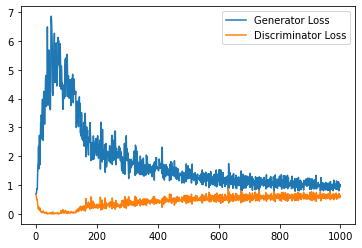

Step 20500: Generator loss: 0.9622095415592193, discriminator loss: 0.609308828651905


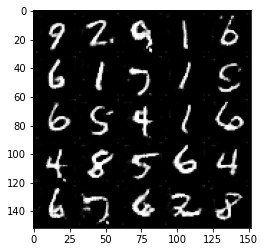

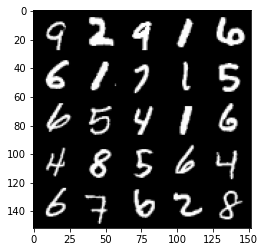

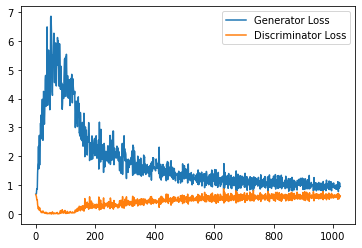

Step 21000: Generator loss: 1.02575151181221, discriminator loss: 0.6137231820821762


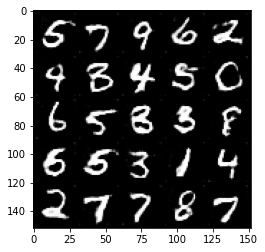

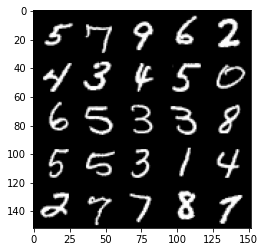

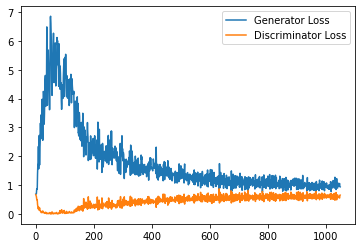

Step 21500: Generator loss: 0.998111718416214, discriminator loss: 0.6188404012322426


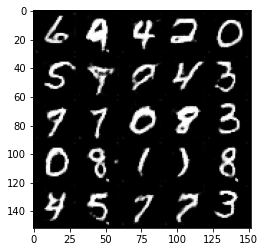

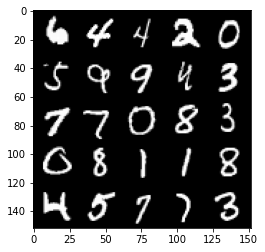

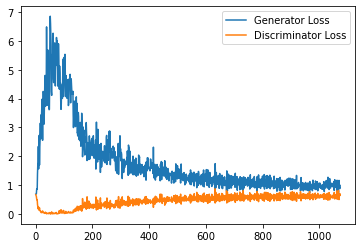

Step 22000: Generator loss: 0.9771484241485596, discriminator loss: 0.6103758336305618


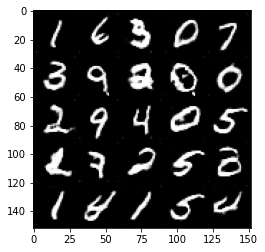

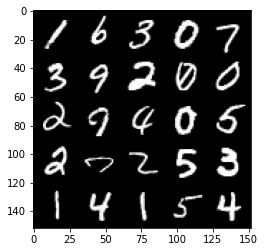

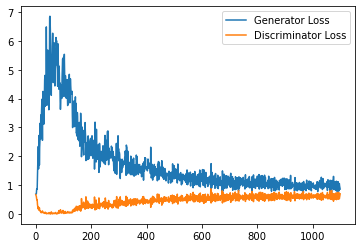

Step 22500: Generator loss: 0.9811570870876313, discriminator loss: 0.6129548151493073


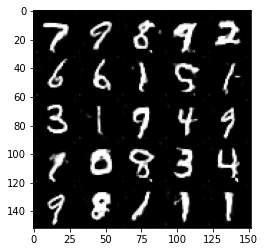

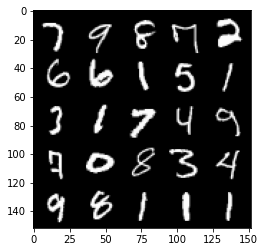

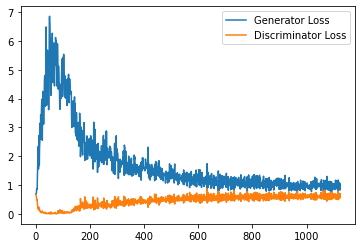

Step 23000: Generator loss: 0.9807599399089814, discriminator loss: 0.6135274640917778


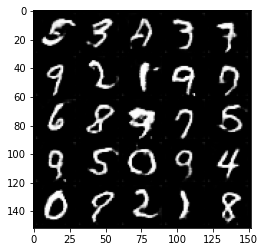

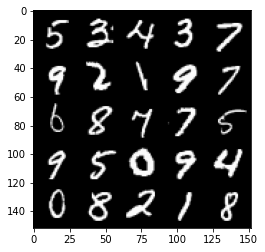

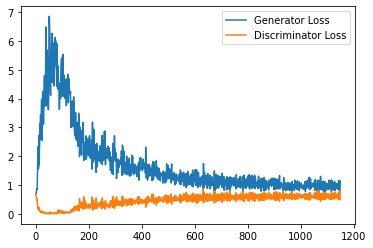

Step 23500: Generator loss: 0.9622458340525627, discriminator loss: 0.6147145535349846


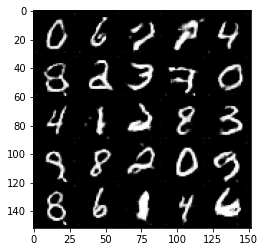

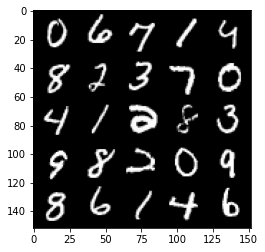

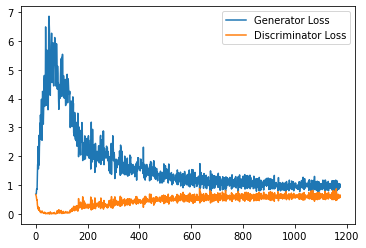

Step 24000: Generator loss: 0.9675869615077972, discriminator loss: 0.611207352757454


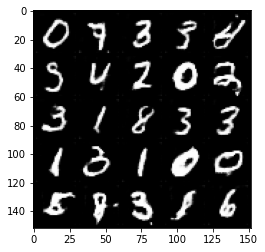

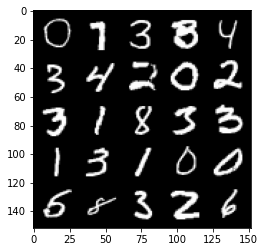

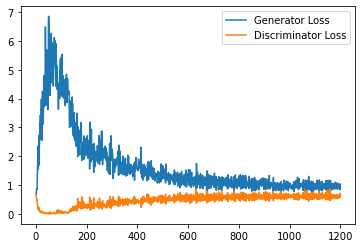

Step 24500: Generator loss: 0.9697440114021302, discriminator loss: 0.6076585836410523


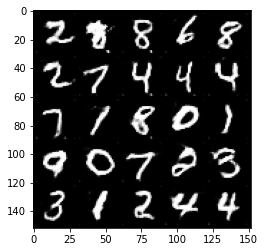

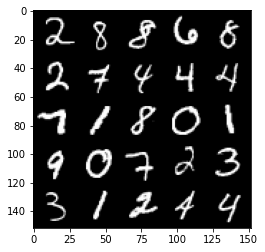

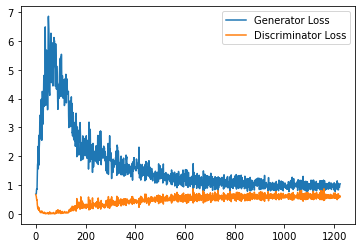

Step 25000: Generator loss: 0.9588056596517562, discriminator loss: 0.6197358610630035


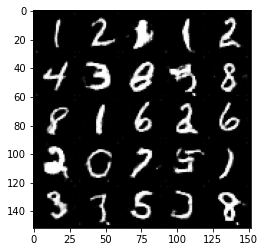

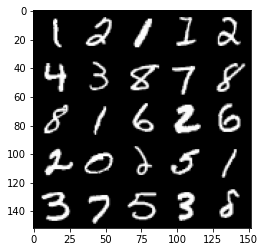

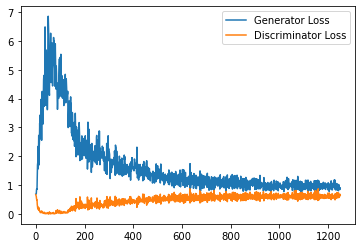

Step 25500: Generator loss: 0.9494260941743851, discriminator loss: 0.6156072328090668


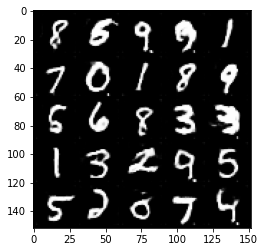

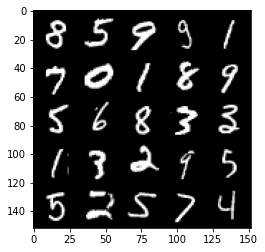

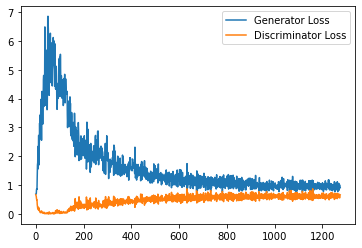

Step 26000: Generator loss: 0.9389925636053086, discriminator loss: 0.6107798961997032


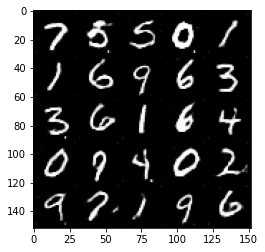

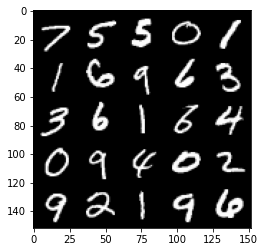

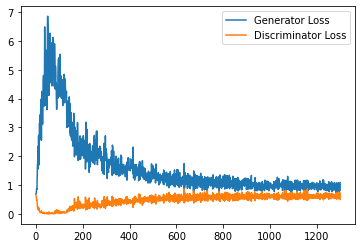

Step 26500: Generator loss: 0.9659958069324494, discriminator loss: 0.6128645333647728


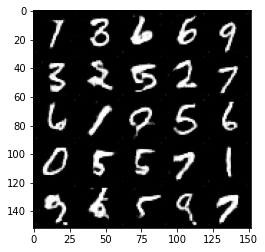

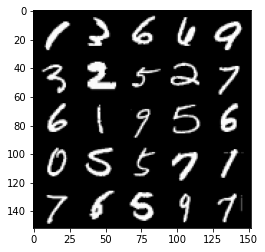

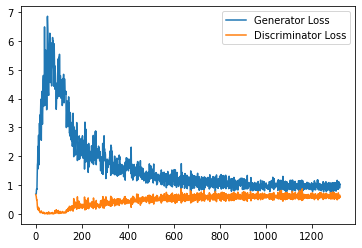

Step 27000: Generator loss: 0.9773868088722228, discriminator loss: 0.6143156602978707


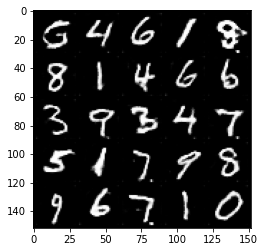

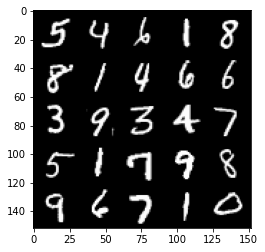

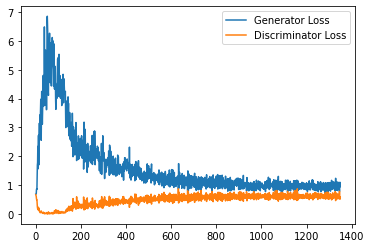

Step 27500: Generator loss: 0.9448917592763901, discriminator loss: 0.6198081033229828


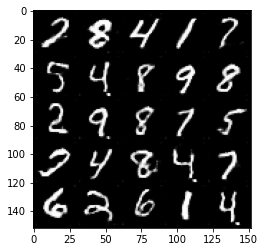

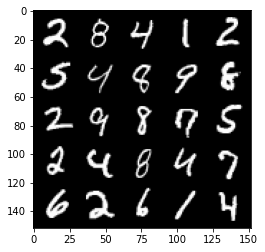

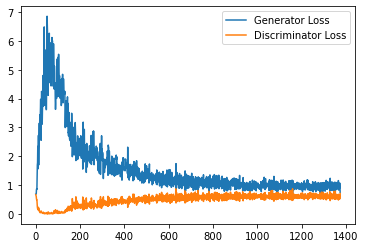

Step 28000: Generator loss: 0.9515160096883774, discriminator loss: 0.6147896015644073


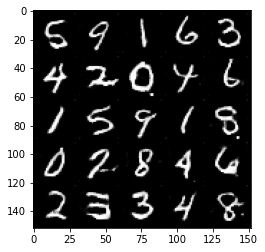

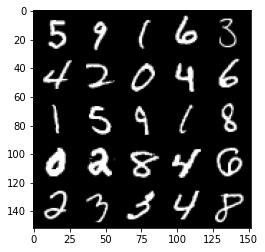

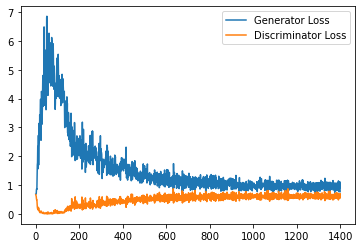

Step 28500: Generator loss: 0.9376820698976517, discriminator loss: 0.6157522209882736


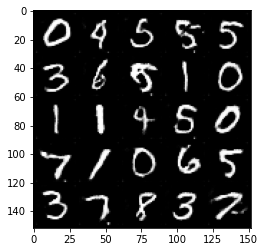

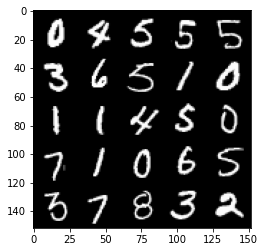

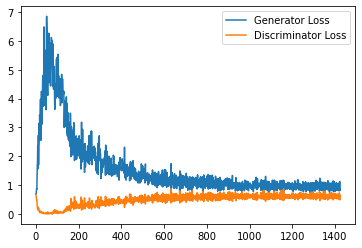

Step 29000: Generator loss: 0.967770657658577, discriminator loss: 0.6169409062862397


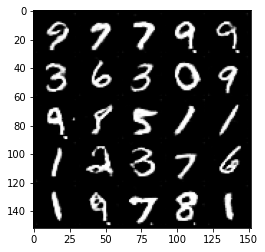

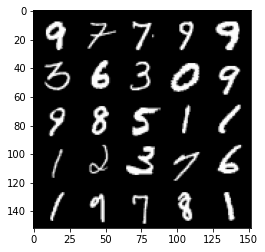

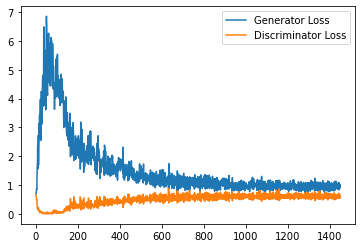

Step 29500: Generator loss: 0.9457445157766342, discriminator loss: 0.6201971852183342


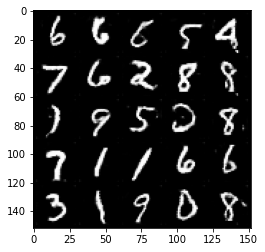

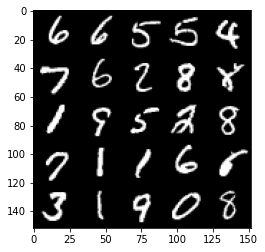

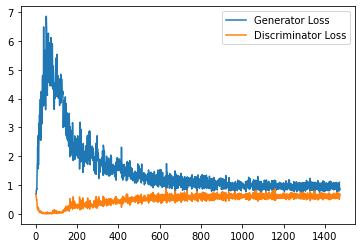

Step 30000: Generator loss: 0.9496580967903138, discriminator loss: 0.6153689566850662


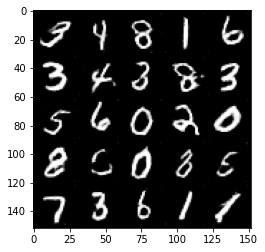

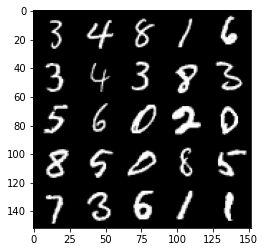

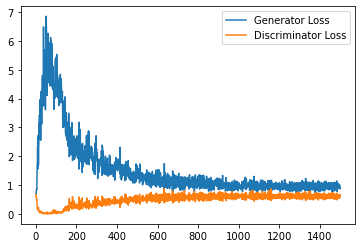

Step 30500: Generator loss: 0.9478924857378006, discriminator loss: 0.6131742877960205


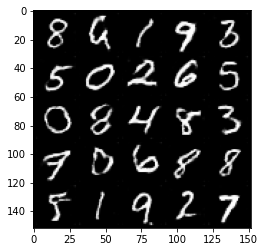

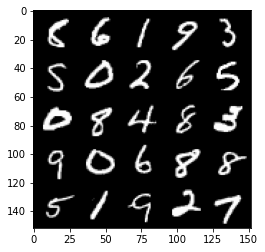

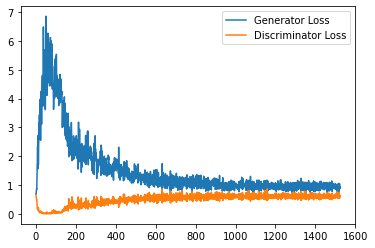

Step 31000: Generator loss: 0.9424693922996521, discriminator loss: 0.6159132277369499


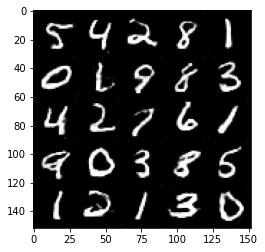

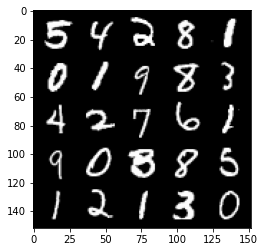

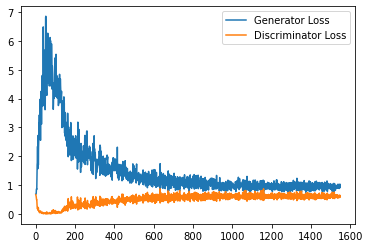

Step 31500: Generator loss: 0.9561001567840576, discriminator loss: 0.6179265342354775


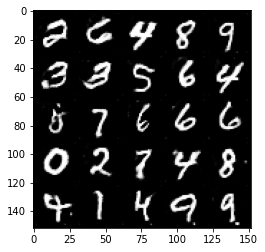

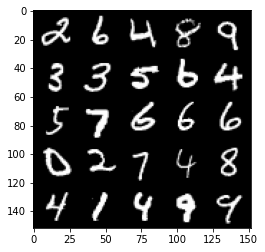

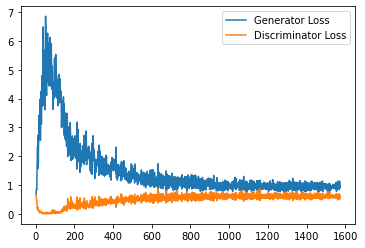

Step 32000: Generator loss: 0.9696458100080491, discriminator loss: 0.6140247387290001


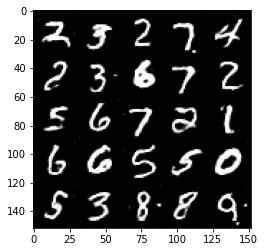

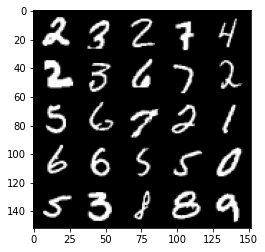

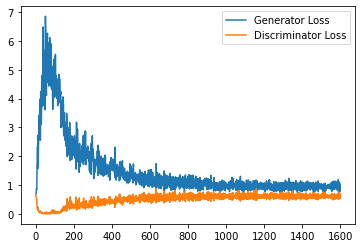

Step 32500: Generator loss: 0.9339817930459976, discriminator loss: 0.6155470062494278


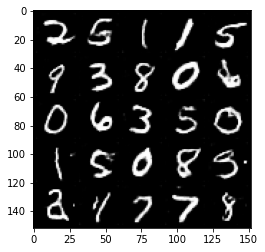

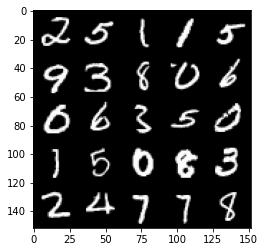

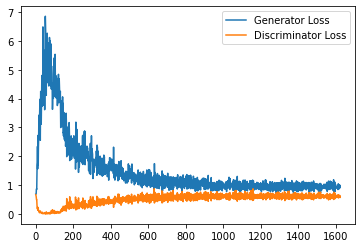

Step 33000: Generator loss: 0.9463157868385315, discriminator loss: 0.6188148136138916


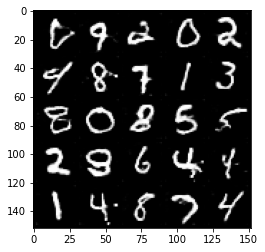

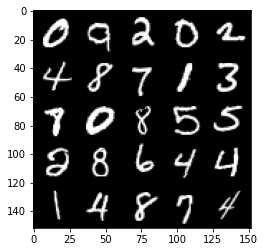

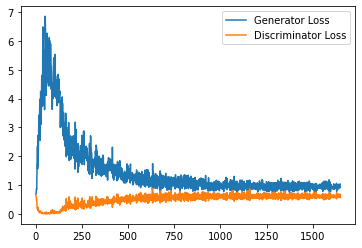

Step 33500: Generator loss: 0.9385632054805756, discriminator loss: 0.6227900460958481


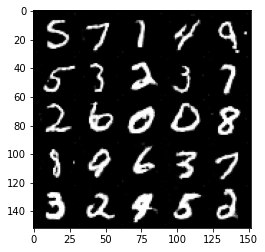

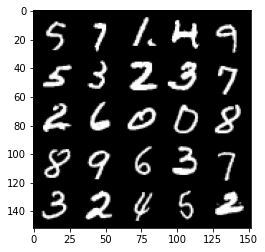

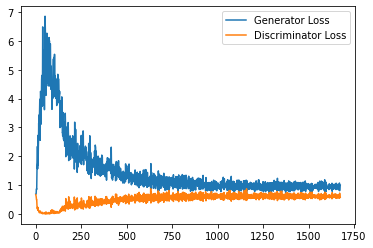

Step 34000: Generator loss: 0.9540226998329162, discriminator loss: 0.6184059855341911


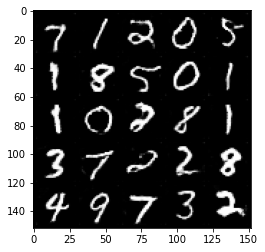

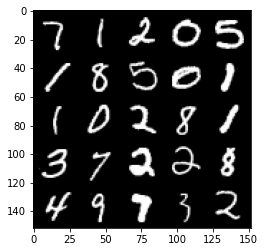

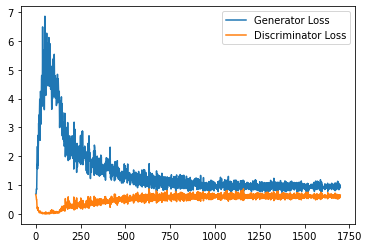

Step 34500: Generator loss: 0.9494688936471939, discriminator loss: 0.6240193887948989


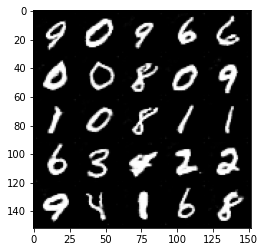

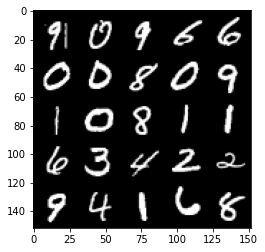

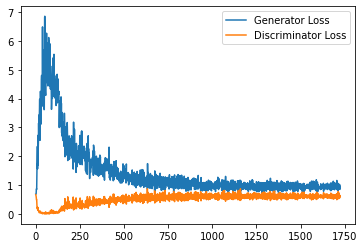

Step 35000: Generator loss: 0.9296962431669236, discriminator loss: 0.6231505594849587


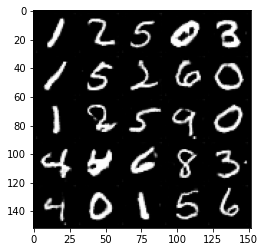

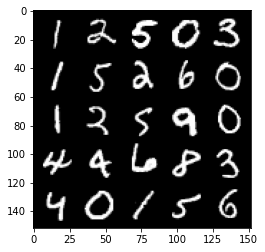

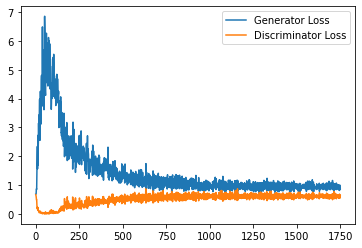

Step 35500: Generator loss: 0.9278245587348938, discriminator loss: 0.6211444880366326


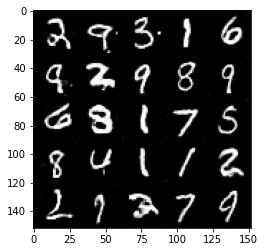

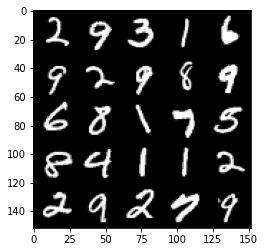

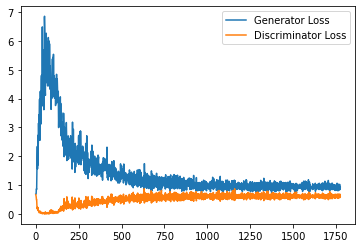

Step 36000: Generator loss: 0.9245047758817673, discriminator loss: 0.6217735348939896


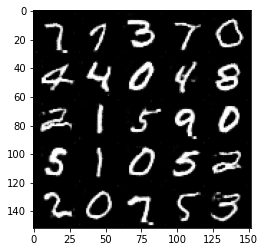

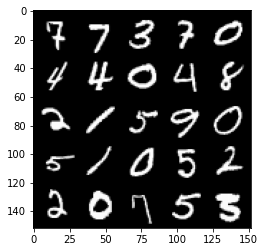

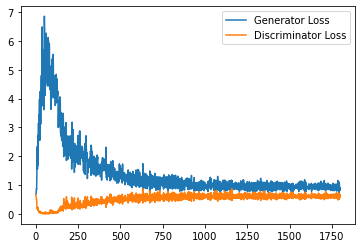

Step 36500: Generator loss: 0.9294284390211105, discriminator loss: 0.6186920088529587


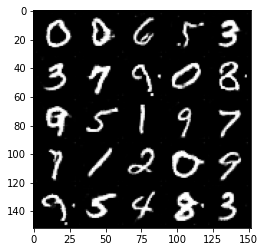

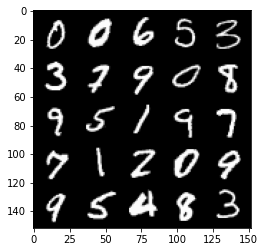

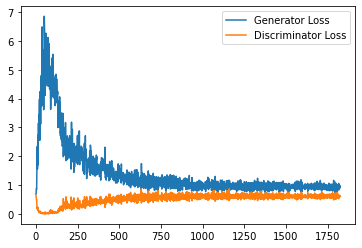

Step 37000: Generator loss: 0.9567287347316742, discriminator loss: 0.6206870908737183


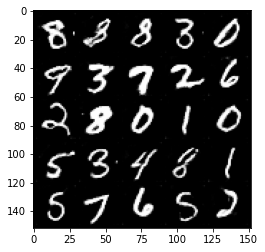

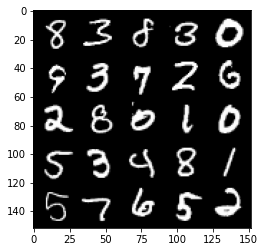

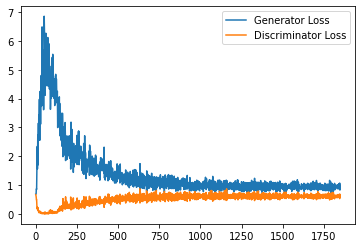

Step 37500: Generator loss: 0.9485763691663742, discriminator loss: 0.6191259791851044


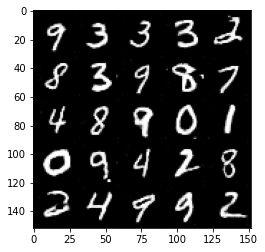

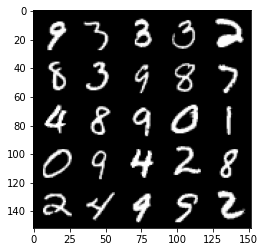

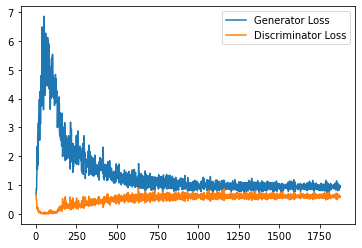

Step 38000: Generator loss: 0.9353717272281646, discriminator loss: 0.6251349512338639


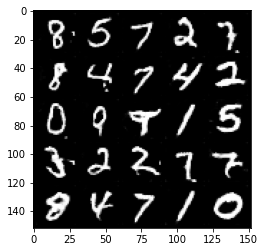

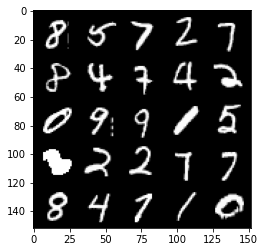

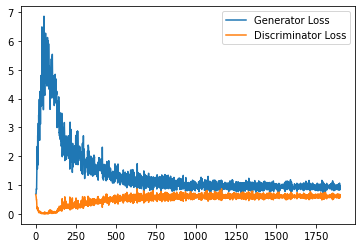

Step 38500: Generator loss: 0.9394861699342728, discriminator loss: 0.6147056017518043


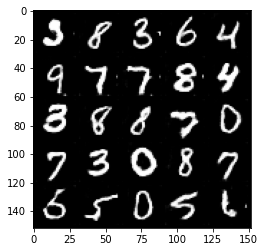

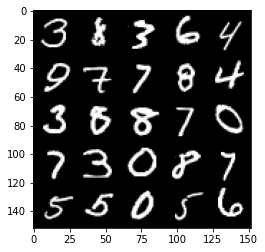

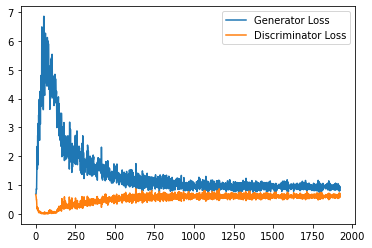

Step 39000: Generator loss: 0.939997304558754, discriminator loss: 0.6136788877844811


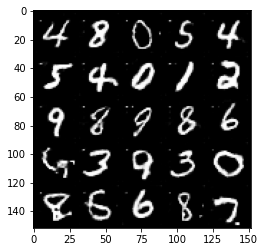

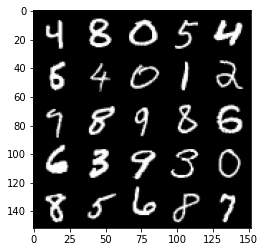

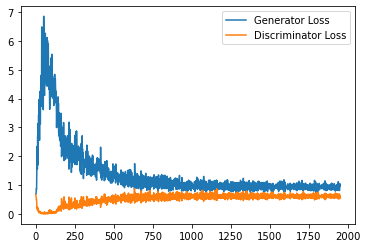

Step 39500: Generator loss: 0.9516930675506592, discriminator loss: 0.609408486187458


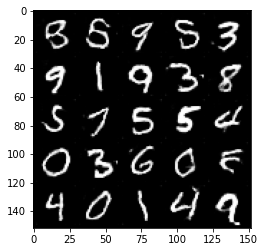

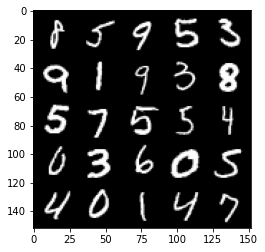

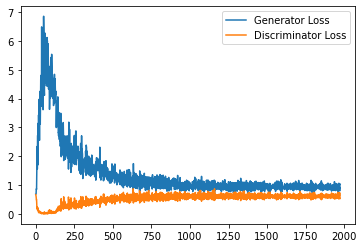

Step 40000: Generator loss: 0.9247724204063416, discriminator loss: 0.6255783384442329


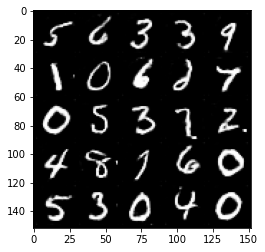

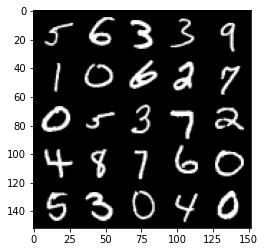

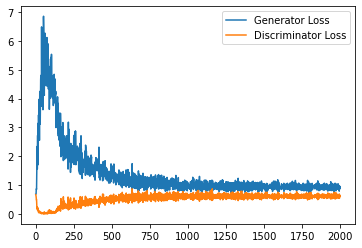

Step 40500: Generator loss: 0.9247143980264664, discriminator loss: 0.6158904082775116


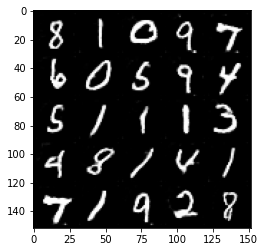

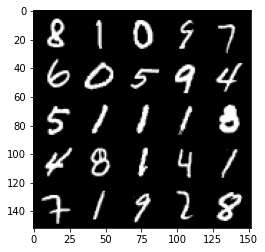

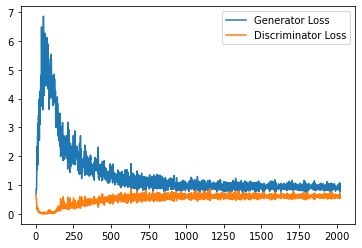

Step 41000: Generator loss: 0.9415014408826828, discriminator loss: 0.6196017751097679


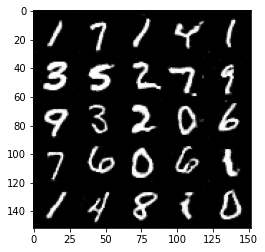

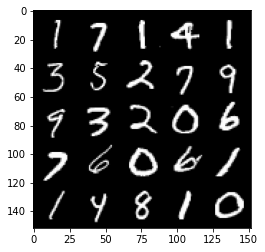

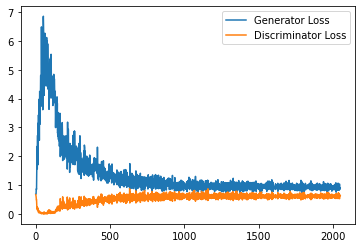

Step 41500: Generator loss: 0.9205506193637848, discriminator loss: 0.6190938791036605


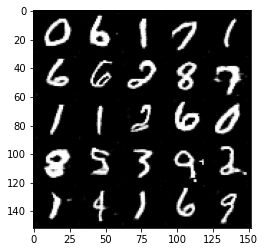

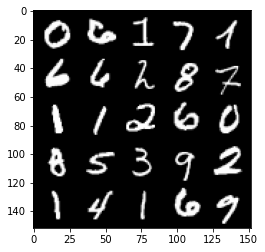

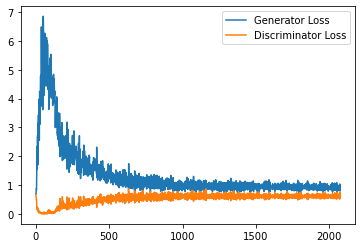

Step 42000: Generator loss: 0.9574230614900588, discriminator loss: 0.6129606284499168


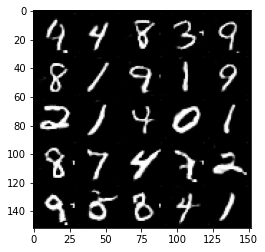

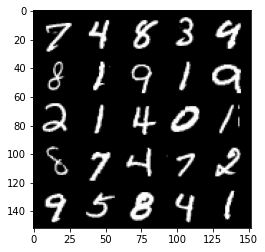

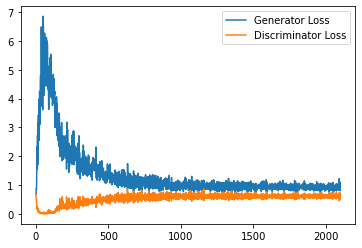

Step 42500: Generator loss: 0.9408980549573899, discriminator loss: 0.6121434315443038


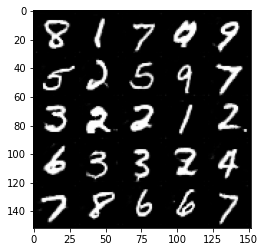

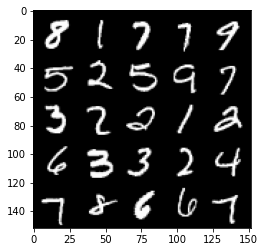

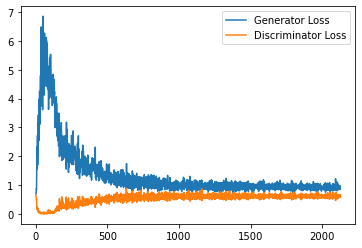

Step 43000: Generator loss: 0.935134833574295, discriminator loss: 0.6083821537494659


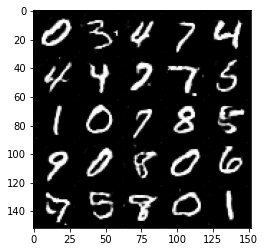

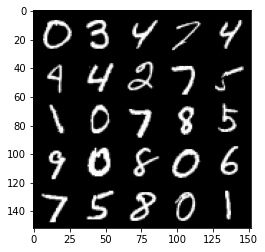

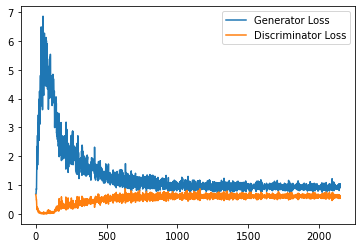

Step 43500: Generator loss: 0.9542214113473892, discriminator loss: 0.617429287970066


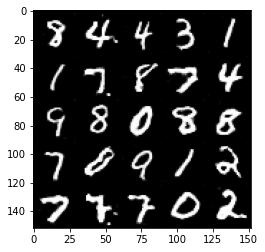

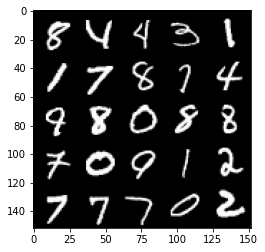

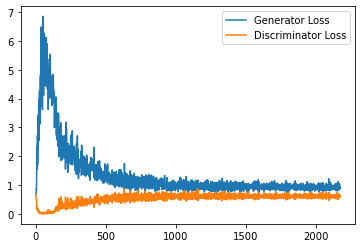

Step 44000: Generator loss: 0.9378127793073654, discriminator loss: 0.6113195925951004


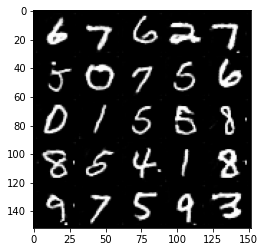

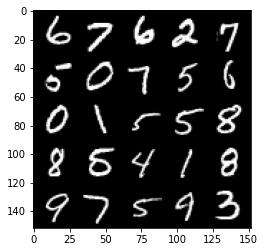

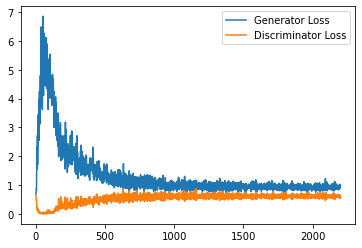

Step 44500: Generator loss: 0.9315448492765427, discriminator loss: 0.6132729241251945


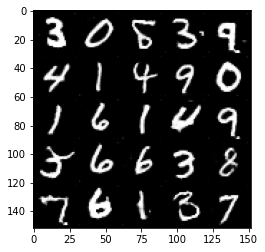

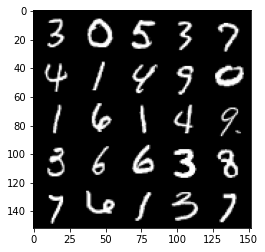

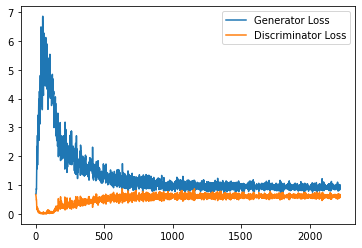

Step 45000: Generator loss: 0.9474916831254959, discriminator loss: 0.6096681424379349


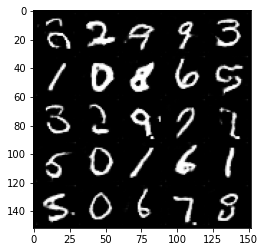

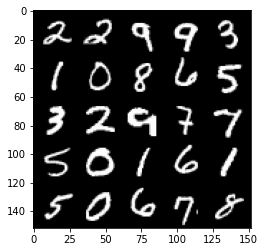

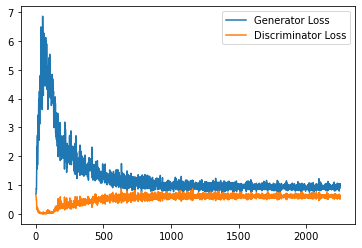

Step 45500: Generator loss: 0.945138533115387, discriminator loss: 0.6114173207879067


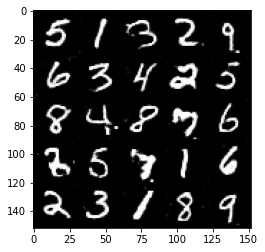

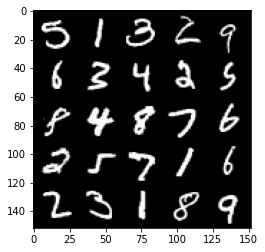

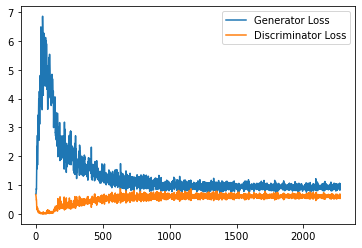

Step 46000: Generator loss: 0.9584730523824692, discriminator loss: 0.6139044120907784


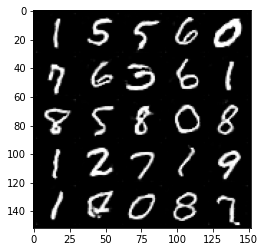

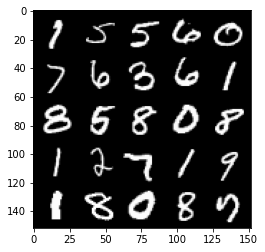

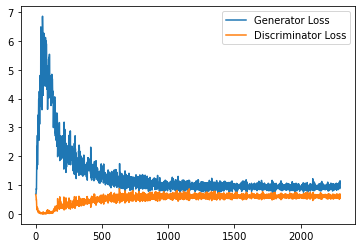

Step 46500: Generator loss: 0.948806521654129, discriminator loss: 0.6216925470232963


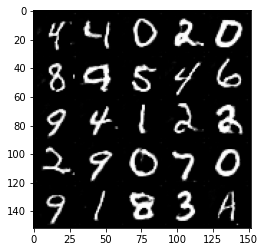

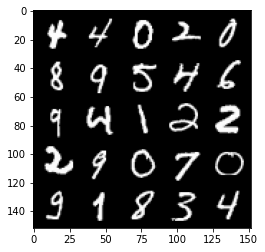

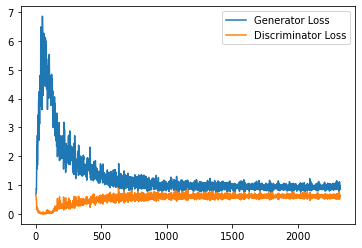

Step 47000: Generator loss: 0.9327755444049836, discriminator loss: 0.6122892201542854


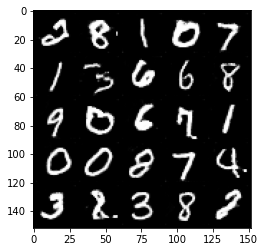

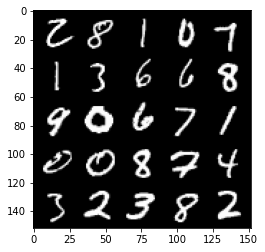

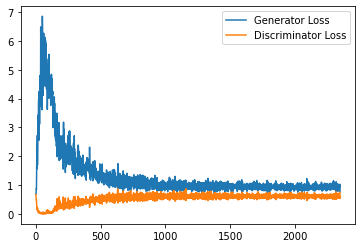

Step 47500: Generator loss: 0.9458699960708619, discriminator loss: 0.6150510384440422


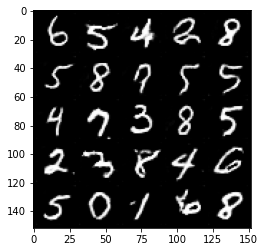

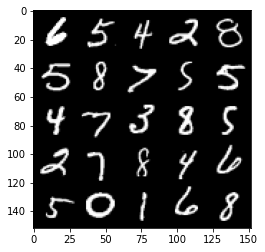

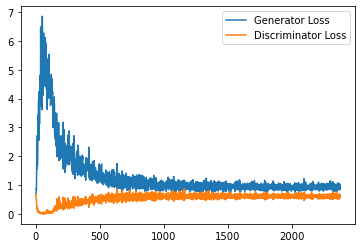

Step 48000: Generator loss: 0.9307048560380936, discriminator loss: 0.6119595929384232


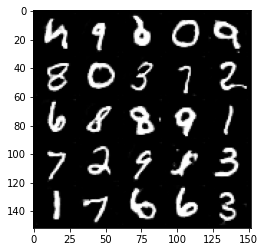

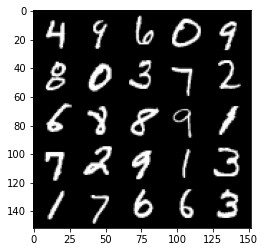

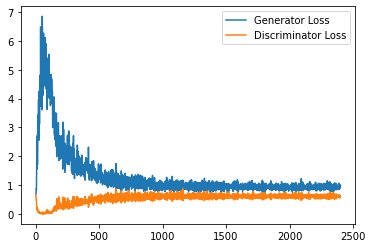

Step 48500: Generator loss: 0.9848766151666641, discriminator loss: 0.6120595441460609


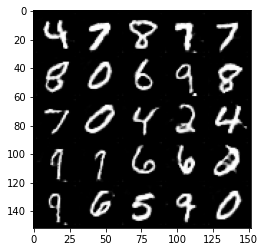

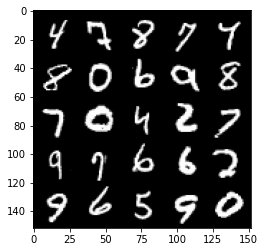

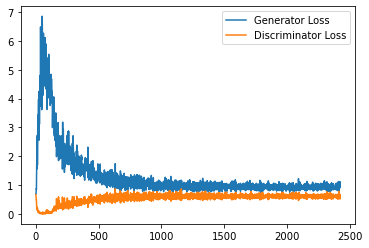

Step 49000: Generator loss: 0.9363129853010178, discriminator loss: 0.6117221155166626


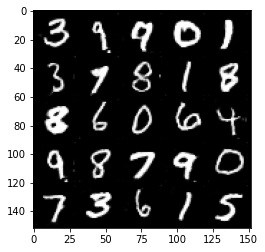

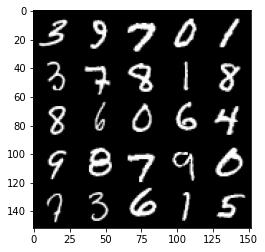

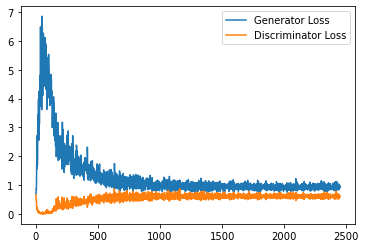

Step 49500: Generator loss: 0.9488329513072967, discriminator loss: 0.6075515166521073


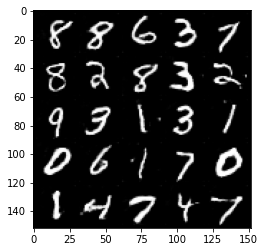

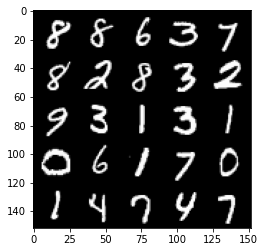

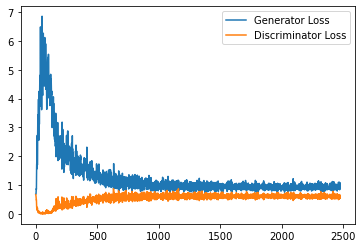

Step 50000: Generator loss: 0.9644793139696122, discriminator loss: 0.6077721631526947


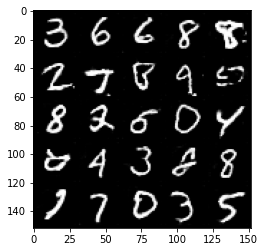

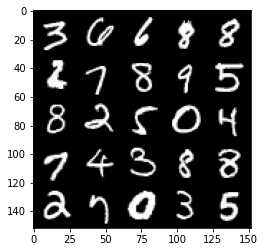

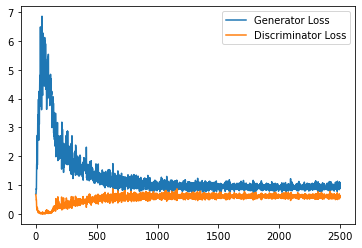

Step 50500: Generator loss: 0.9535849405527115, discriminator loss: 0.6088921377658844


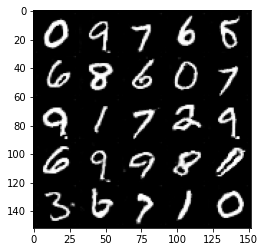

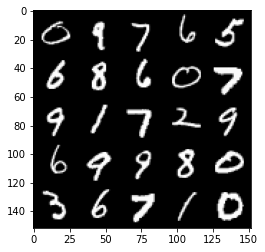

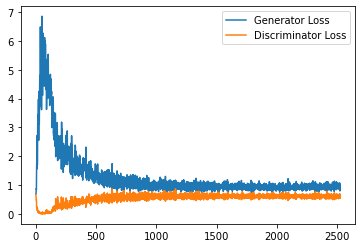

Step 51000: Generator loss: 0.950140241265297, discriminator loss: 0.6151212485432624


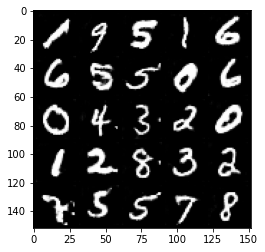

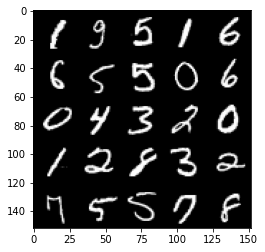

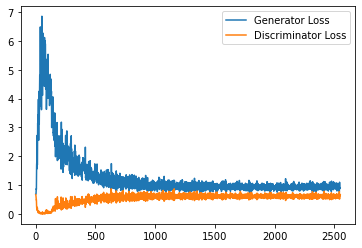

Step 51500: Generator loss: 0.9779650794267655, discriminator loss: 0.6064665378928185


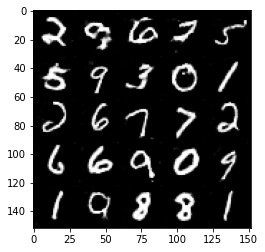

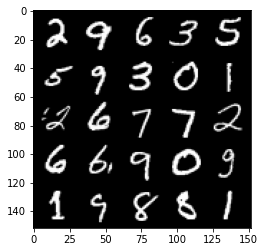

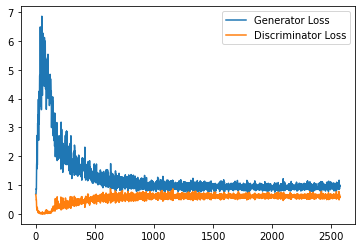

Step 52000: Generator loss: 0.9524458791017533, discriminator loss: 0.6187275480628014


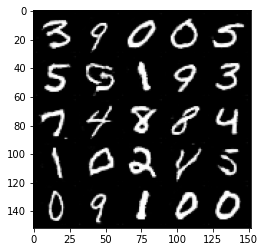

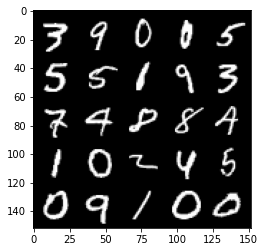

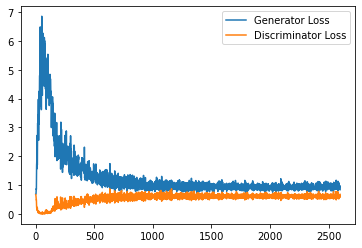

Step 52500: Generator loss: 0.9586639710664749, discriminator loss: 0.6085856328010559


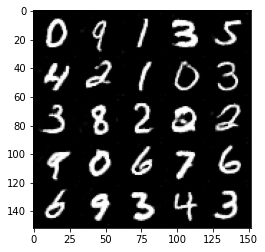

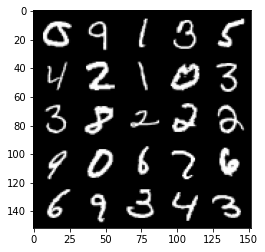

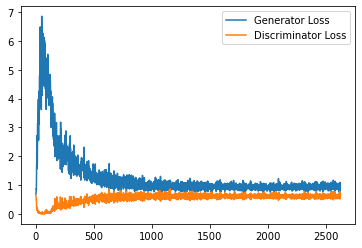

Step 53000: Generator loss: 0.9435996912717819, discriminator loss: 0.6080591504573822


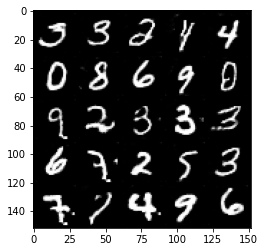

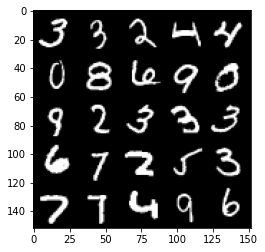

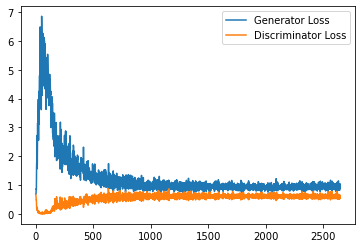

Step 53500: Generator loss: 0.9543250700235367, discriminator loss: 0.606127303481102


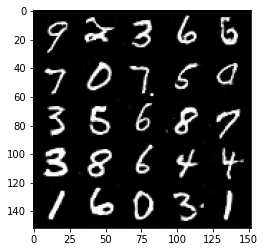

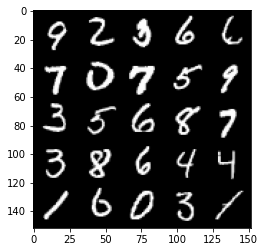

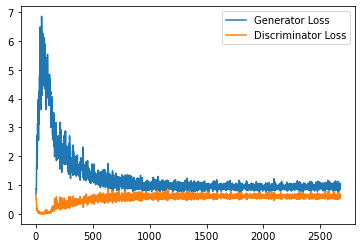

Step 54000: Generator loss: 0.9694545737504959, discriminator loss: 0.6059944959878921


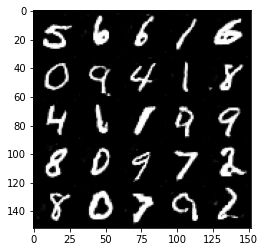

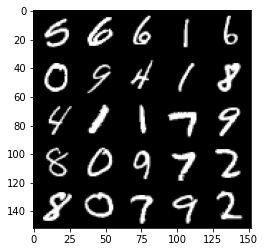

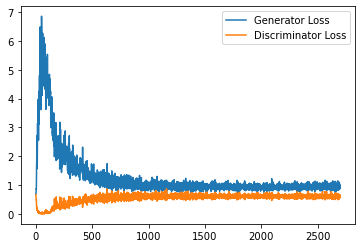

Step 54500: Generator loss: 0.9635678687095642, discriminator loss: 0.6050105187892914


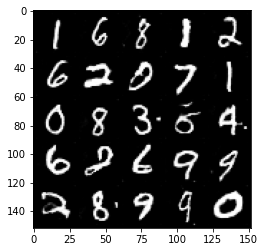

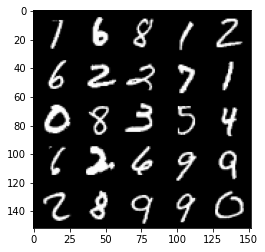

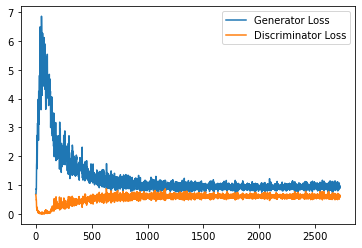

Step 55000: Generator loss: 0.9609756934642791, discriminator loss: 0.6033510088920593


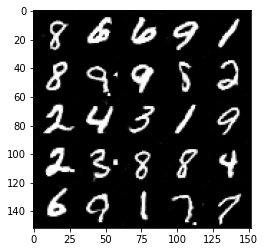

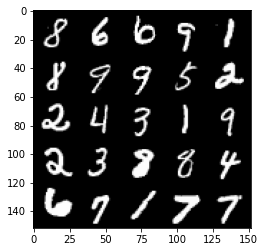

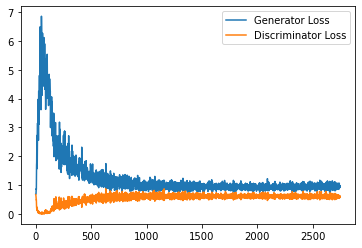

Step 55500: Generator loss: 0.9474887779951096, discriminator loss: 0.6128362960219383


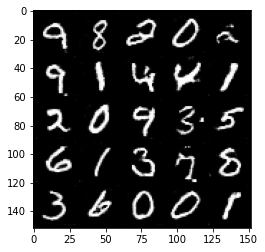

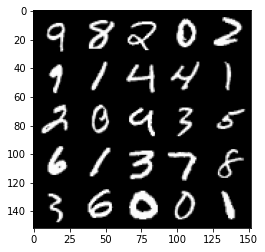

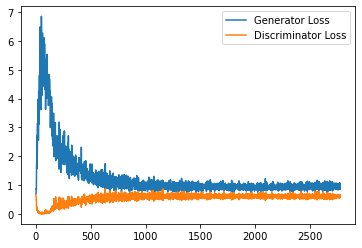

Step 56000: Generator loss: 0.9860437980890274, discriminator loss: 0.6041628075838089


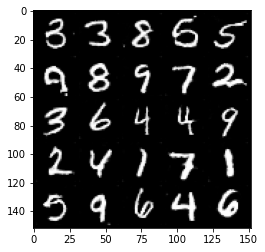

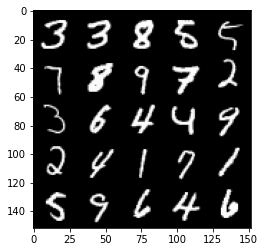

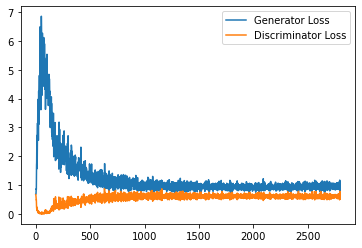

Step 56500: Generator loss: 0.9569825824499131, discriminator loss: 0.607681879401207


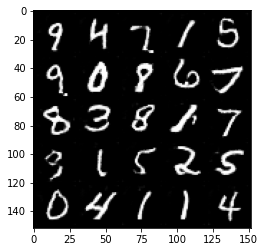

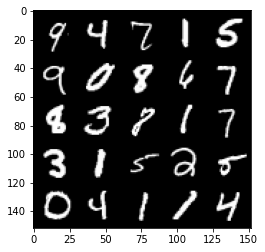

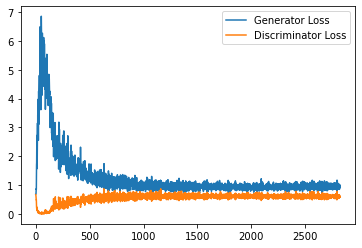

Step 57000: Generator loss: 0.965864337682724, discriminator loss: 0.6026170872449875


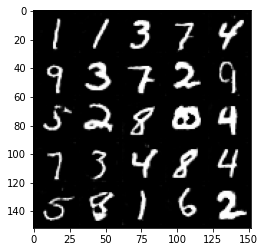

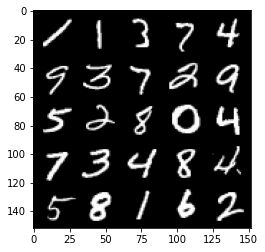

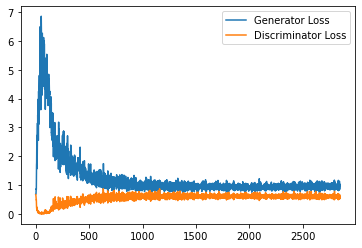

Step 57500: Generator loss: 0.9748416488170624, discriminator loss: 0.6018213877677917


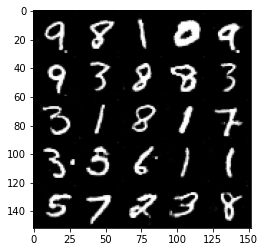

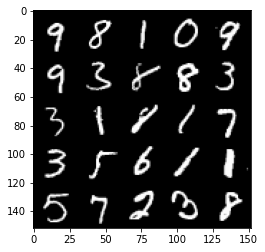

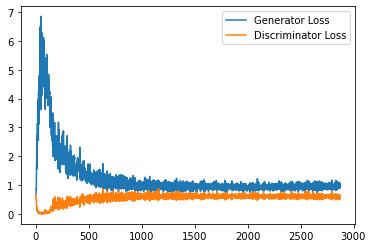

Step 58000: Generator loss: 0.96928440284729, discriminator loss: 0.6056703757047653


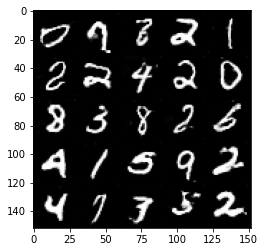

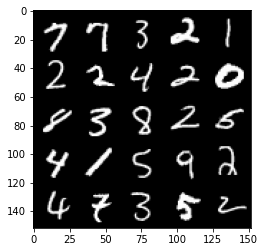

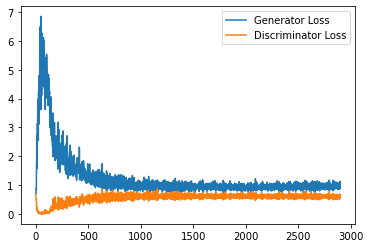

Step 58500: Generator loss: 0.9684852575063705, discriminator loss: 0.6084654132723808


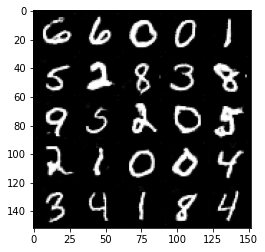

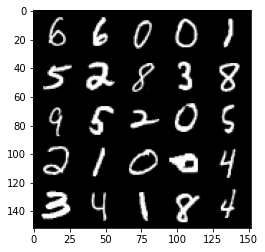

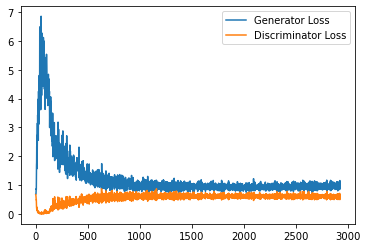

Step 59000: Generator loss: 0.9810967499017715, discriminator loss: 0.6025308675765991


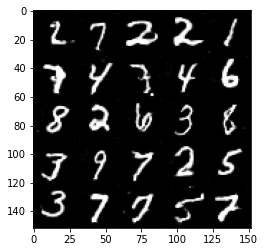

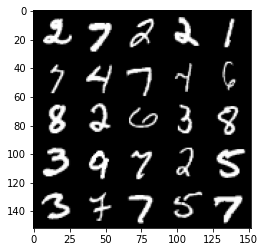

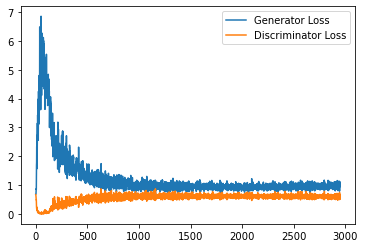

Step 59500: Generator loss: 0.9668535455465317, discriminator loss: 0.6039760810732842


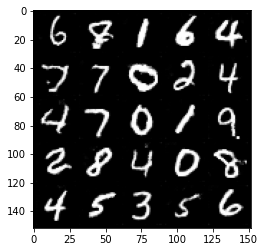

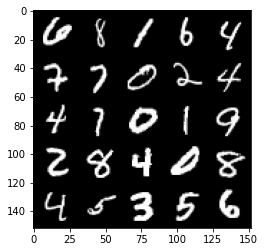

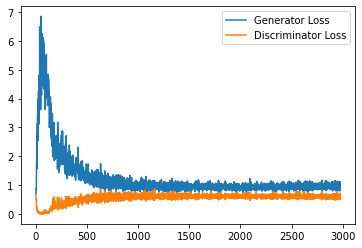

Step 60000: Generator loss: 0.9625638371706009, discriminator loss: 0.6002427619099617


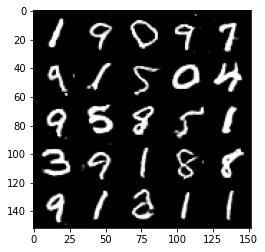

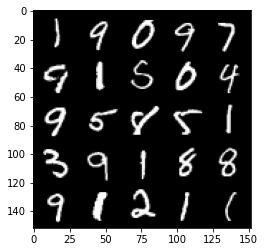

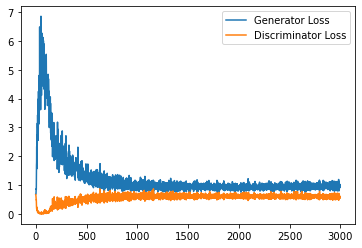

Step 60500: Generator loss: 0.9722972145080566, discriminator loss: 0.6039824055433274


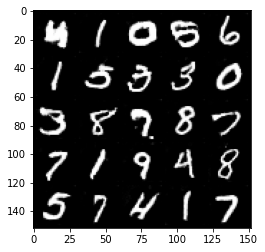

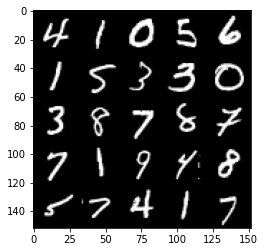

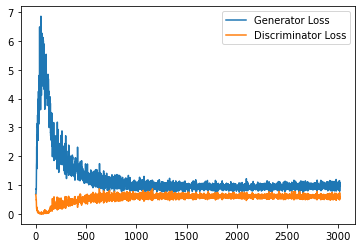

Step 61000: Generator loss: 0.9584435807466507, discriminator loss: 0.6098180319666863


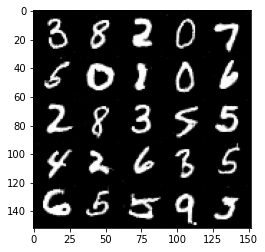

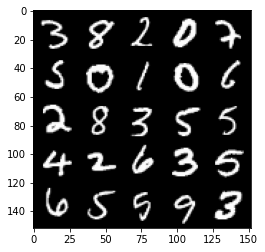

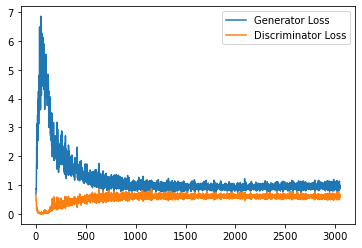

Step 61500: Generator loss: 0.9804691814184189, discriminator loss: 0.5985549675226212


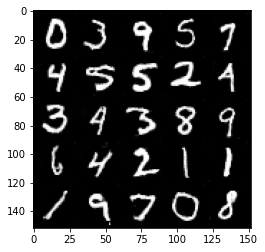

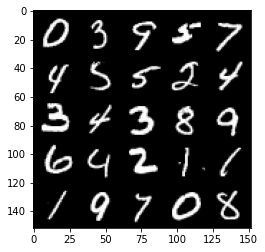

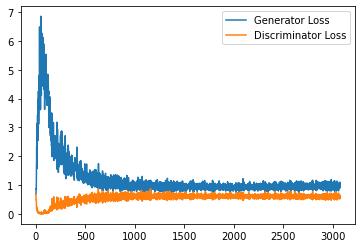

Step 62000: Generator loss: 0.9844879328012467, discriminator loss: 0.599500400185585


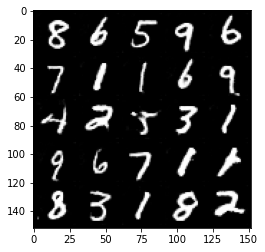

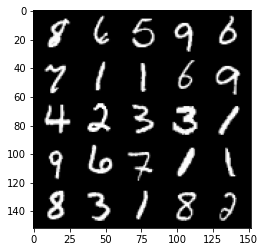

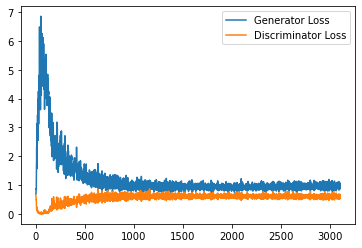

Step 62500: Generator loss: 0.9712696739435196, discriminator loss: 0.6003852926492691


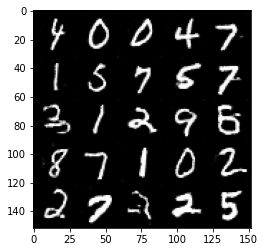

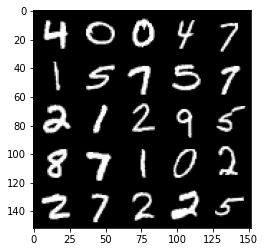

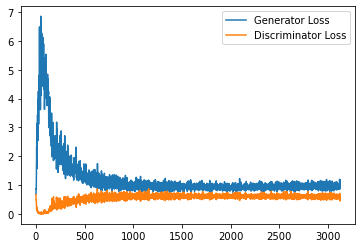

Step 63000: Generator loss: 0.9750775246620178, discriminator loss: 0.6052981404066086


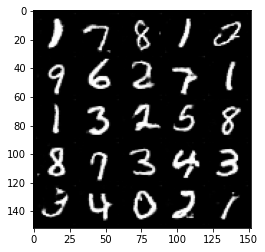

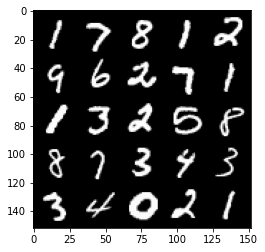

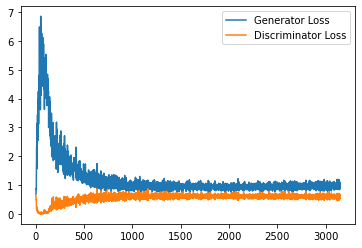

Step 63500: Generator loss: 0.9681937290430069, discriminator loss: 0.5987732867598534


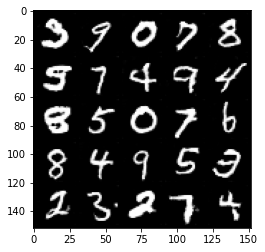

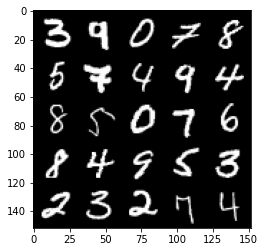

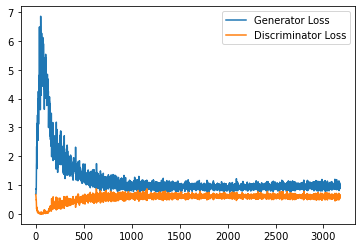

Step 64000: Generator loss: 0.9623727424144745, discriminator loss: 0.598349616408348


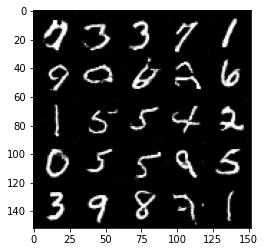

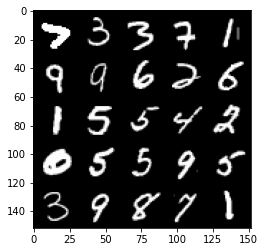

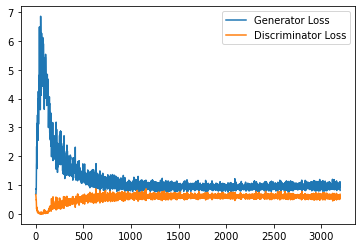

Step 64500: Generator loss: 0.9840256737470627, discriminator loss: 0.5958548712730408


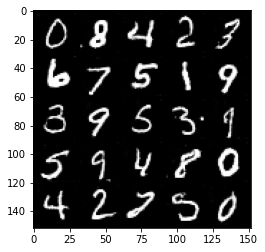

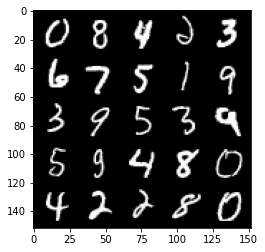

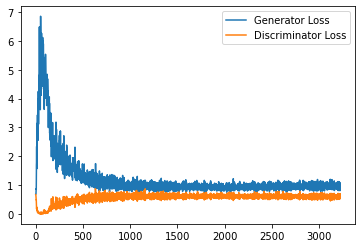

Step 65000: Generator loss: 0.9659462218284607, discriminator loss: 0.60489922362566


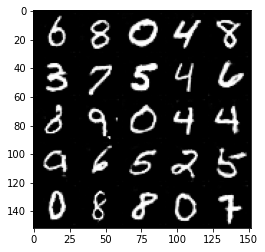

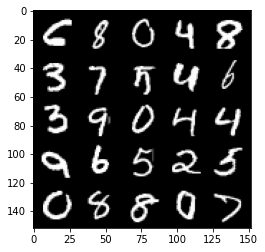

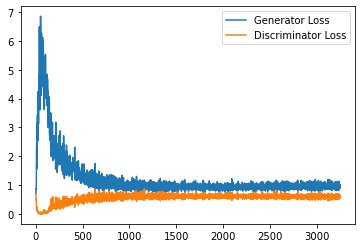

Step 65500: Generator loss: 0.9736342153549195, discriminator loss: 0.5993812565803528


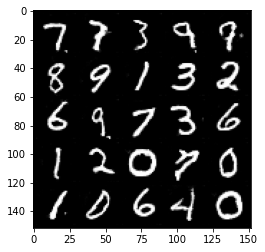

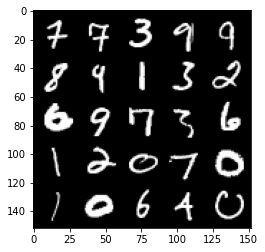

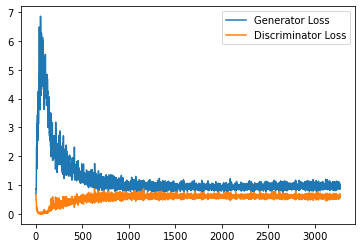

Step 66000: Generator loss: 0.9650049958825111, discriminator loss: 0.6092028268575669


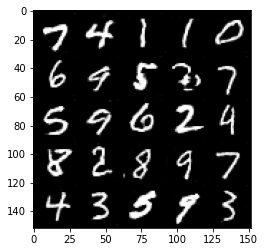

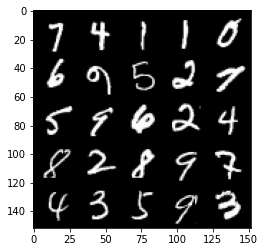

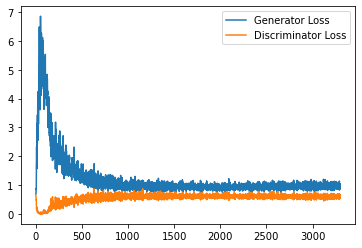

Step 66500: Generator loss: 0.9609300177097321, discriminator loss: 0.6154628999233246


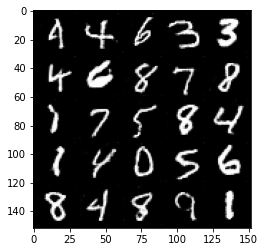

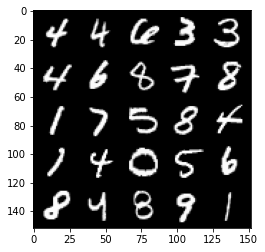

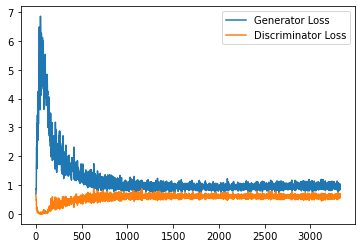

Step 67000: Generator loss: 0.9889990665912628, discriminator loss: 0.6011366608142853


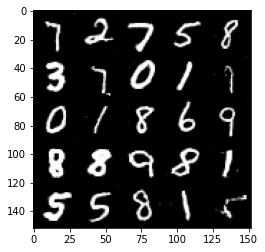

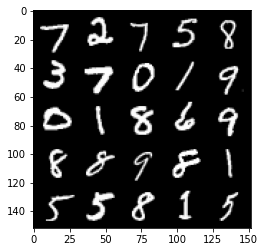

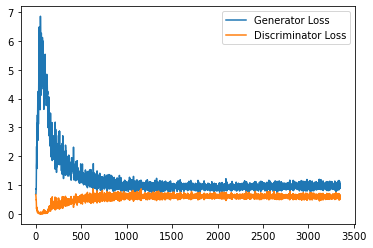

Step 67500: Generator loss: 0.9654632675647735, discriminator loss: 0.60463538646698


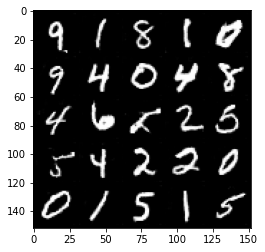

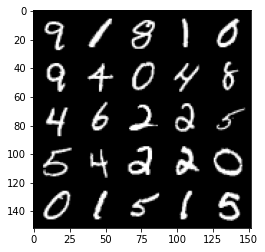

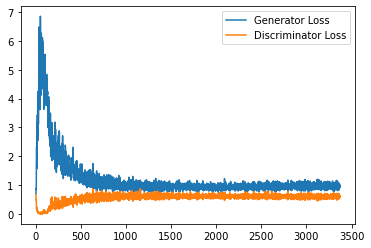

Step 68000: Generator loss: 0.9896240164041519, discriminator loss: 0.6032046329975128


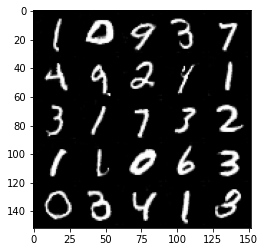

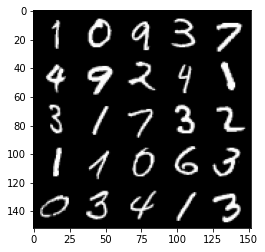

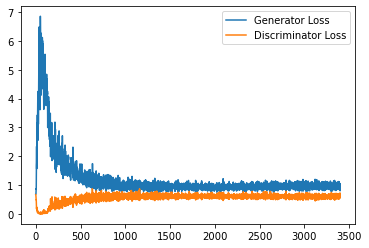

Step 68500: Generator loss: 0.9768906681537628, discriminator loss: 0.6006933934092522


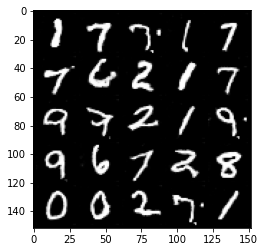

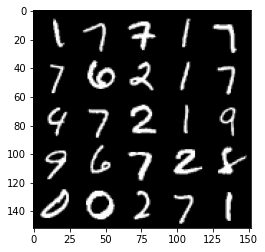

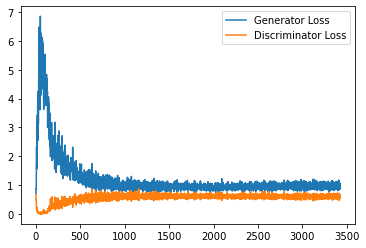

Step 69000: Generator loss: 0.9565671074390412, discriminator loss: 0.6157953892946243


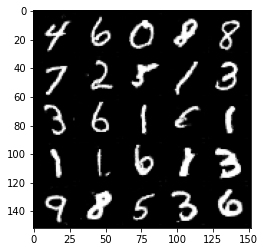

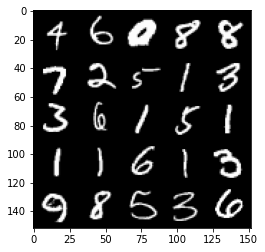

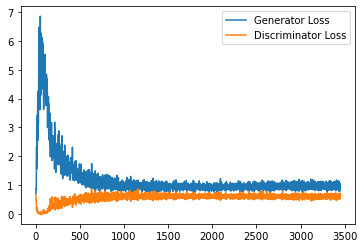

Step 69500: Generator loss: 0.9560187455415726, discriminator loss: 0.6064453110694885


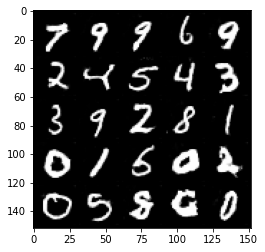

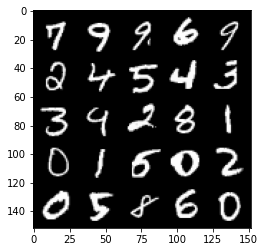

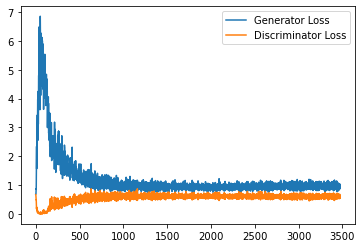

Step 70000: Generator loss: 0.9705602616071701, discriminator loss: 0.6047629262804985


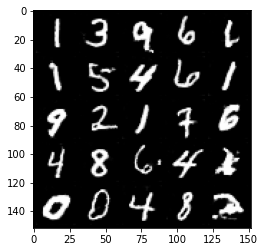

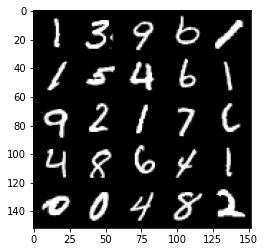

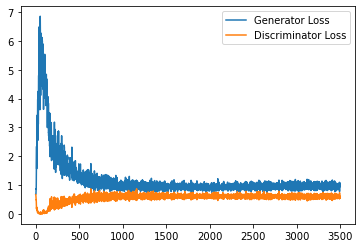

Step 70500: Generator loss: 0.9596923590898514, discriminator loss: 0.6120792780518531


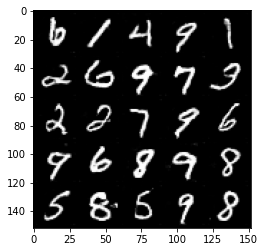

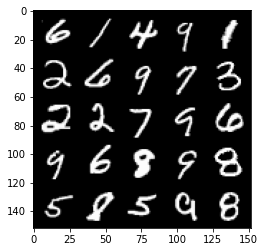

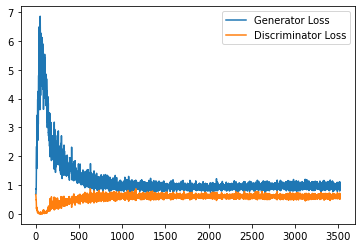

Step 71000: Generator loss: 0.9599014670848847, discriminator loss: 0.6132945195436478


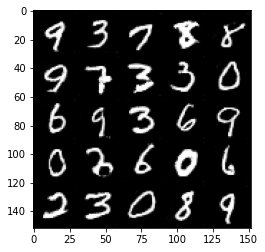

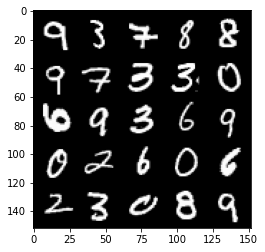

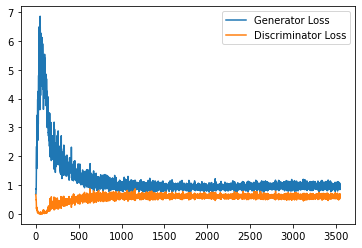

Step 71500: Generator loss: 0.9420488015413284, discriminator loss: 0.6157699223160744


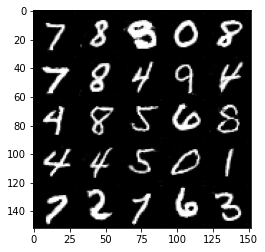

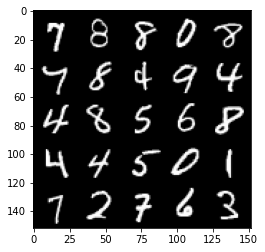

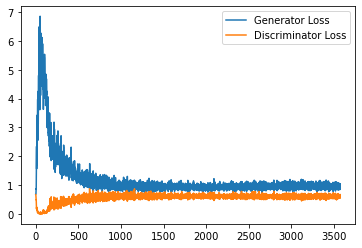

Step 72000: Generator loss: 0.9643903810977936, discriminator loss: 0.604251643717289


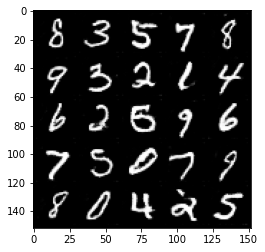

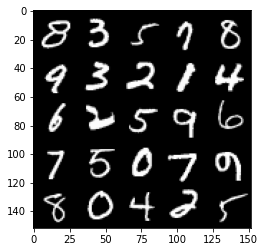

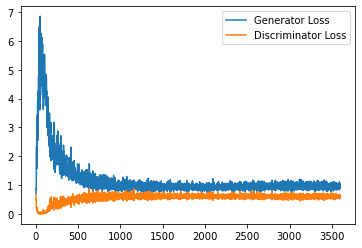

Step 72500: Generator loss: 0.9531130099892616, discriminator loss: 0.619903235912323


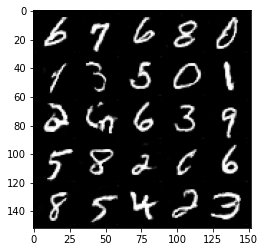

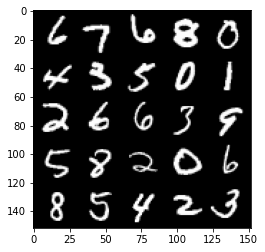

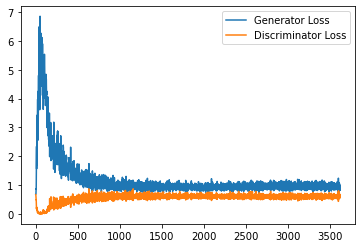

Step 73000: Generator loss: 0.9443626244068146, discriminator loss: 0.6126018443703651


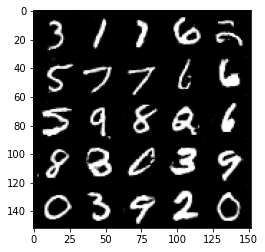

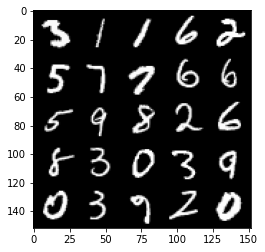

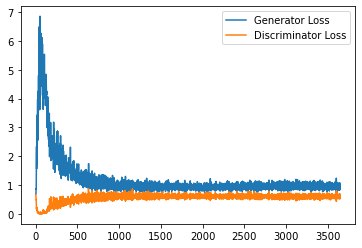

Step 73500: Generator loss: 0.9535090055465698, discriminator loss: 0.6217431755065917


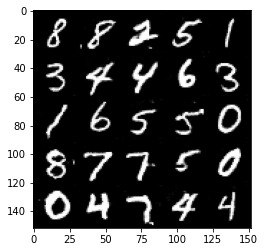

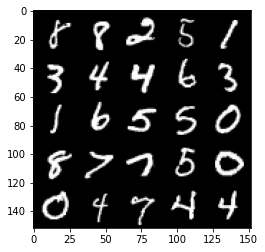

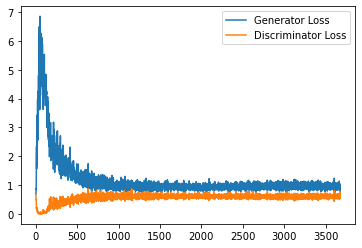

Step 74000: Generator loss: 0.9670265935659409, discriminator loss: 0.6131534566283225


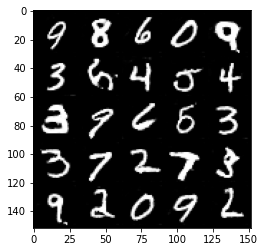

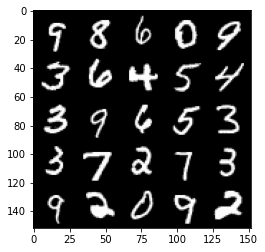

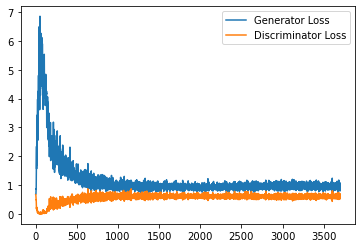

Step 74500: Generator loss: 0.9459466279745102, discriminator loss: 0.612972665309906


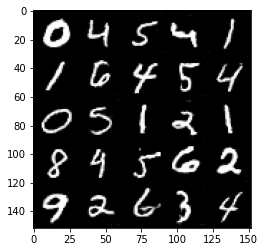

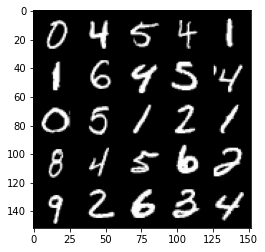

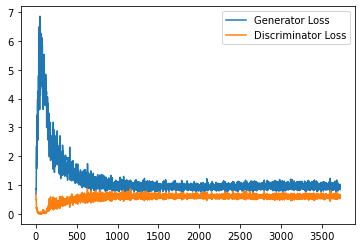

Step 75000: Generator loss: 0.9472421290874481, discriminator loss: 0.6114320793151855


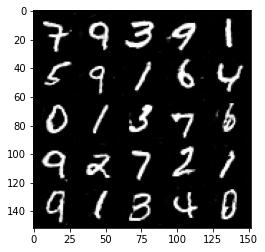

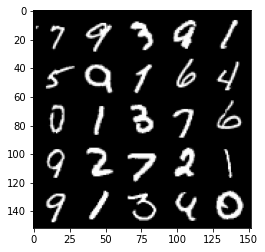

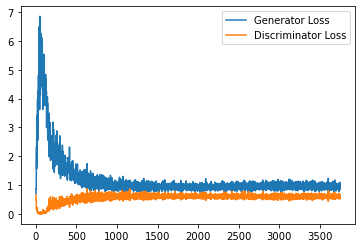

Step 75500: Generator loss: 0.9484823515415192, discriminator loss: 0.6172929495573044


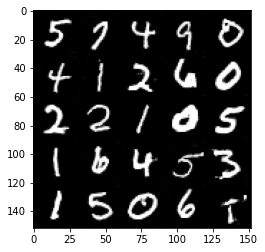

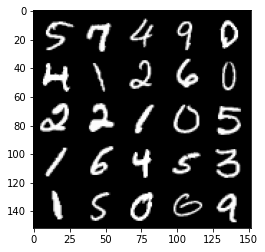

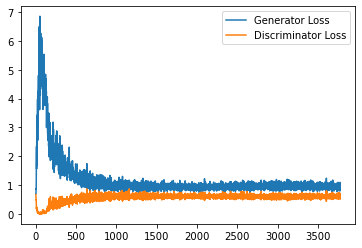

Step 76000: Generator loss: 0.9681838591098786, discriminator loss: 0.6171337051391601


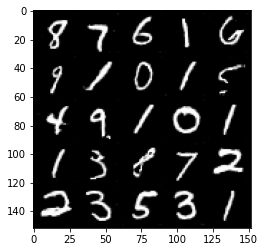

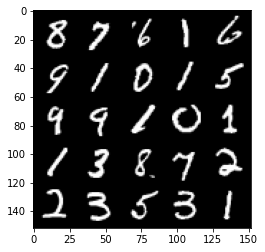

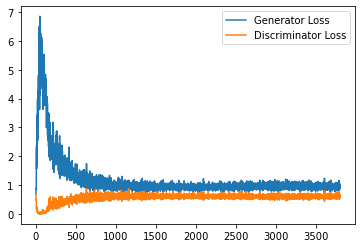

Step 76500: Generator loss: 0.9556428779363633, discriminator loss: 0.6186679033041


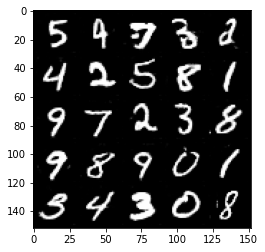

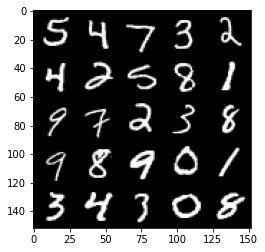

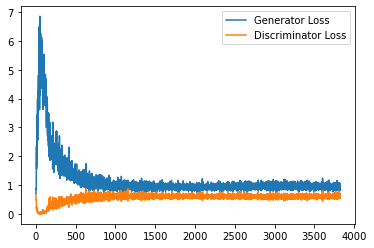

Step 77000: Generator loss: 0.9293898006677628, discriminator loss: 0.6305316646099091


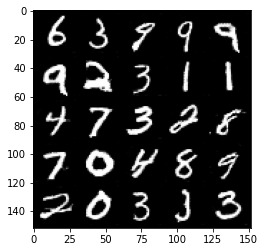

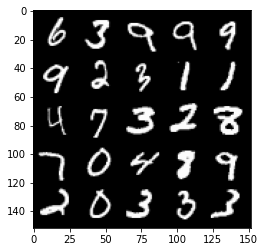

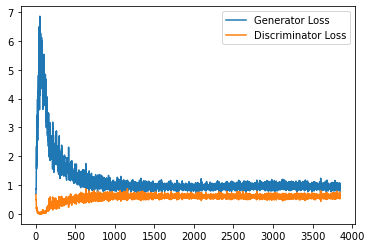

Step 77500: Generator loss: 0.9447651015520095, discriminator loss: 0.6146645123362541


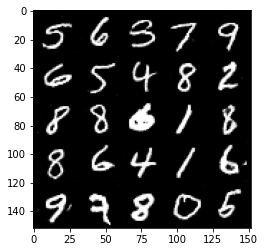

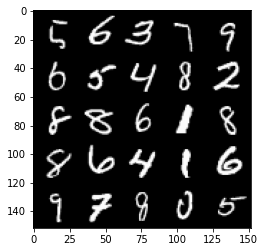

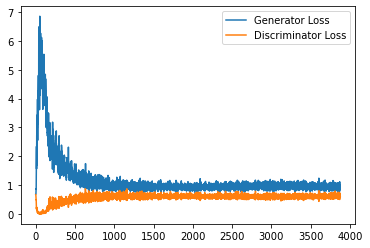

Step 78000: Generator loss: 0.952920285820961, discriminator loss: 0.6204787955880166


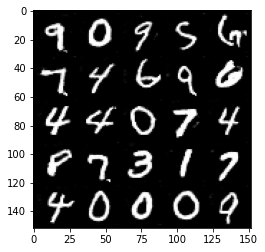

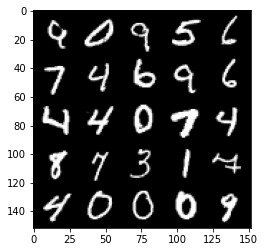

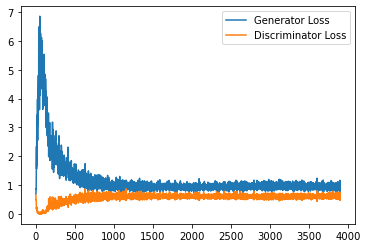

Step 78500: Generator loss: 0.9311739737987519, discriminator loss: 0.623809781908989


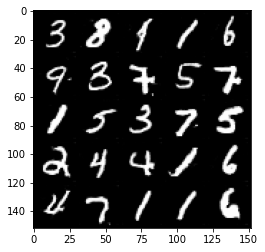

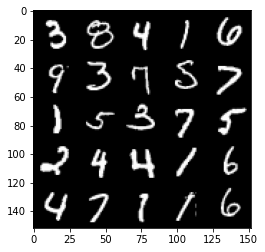

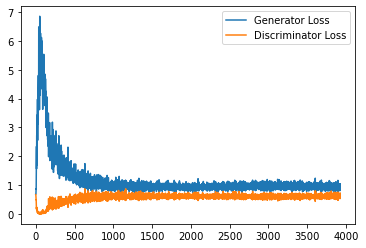

Step 79000: Generator loss: 0.9452477505207062, discriminator loss: 0.6244003299474716


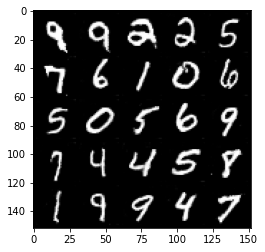

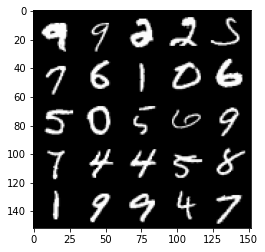

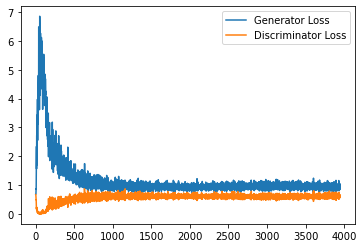

Step 79500: Generator loss: 0.9510076982975006, discriminator loss: 0.6220093961954117


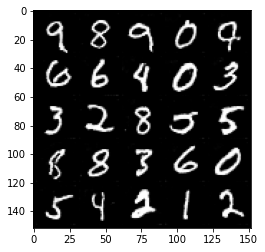

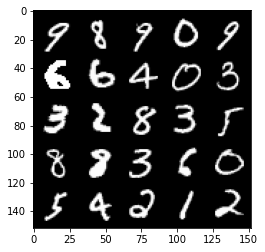

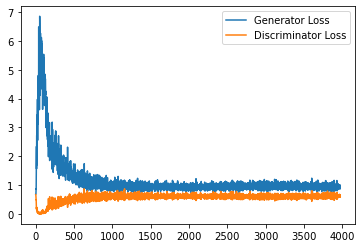

Step 80000: Generator loss: 0.9466653724908829, discriminator loss: 0.6208471386432648


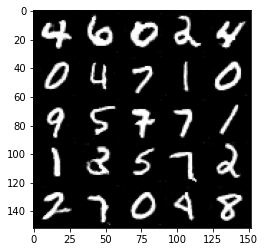

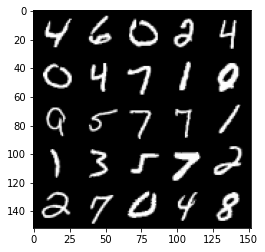

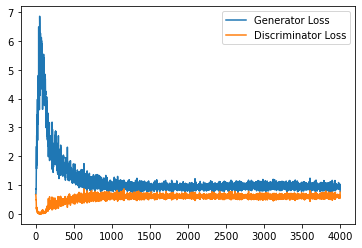

Step 80500: Generator loss: 0.9399832420349121, discriminator loss: 0.618064245223999


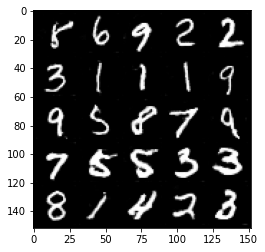

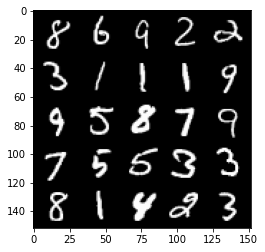

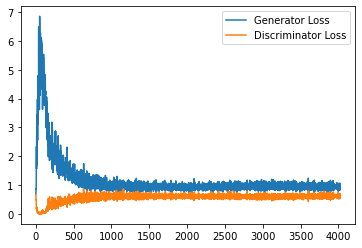

Step 81000: Generator loss: 0.9289175923466683, discriminator loss: 0.6258024854660034


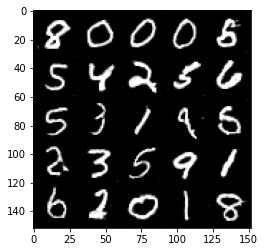

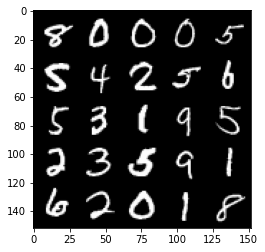

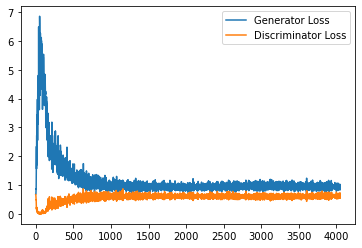

Step 81500: Generator loss: 0.9349342607259751, discriminator loss: 0.6218356944322586


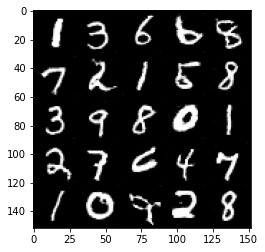

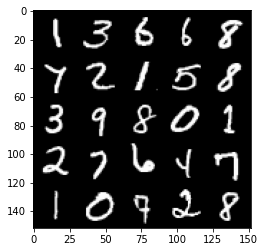

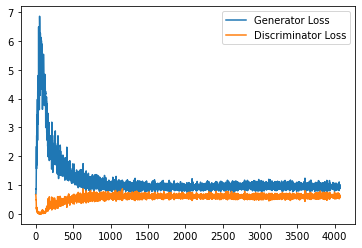

Step 82000: Generator loss: 0.9501002941131592, discriminator loss: 0.621167479634285


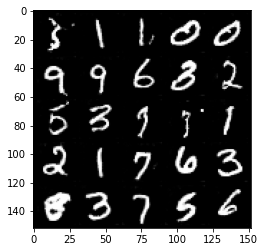

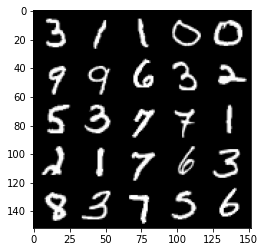

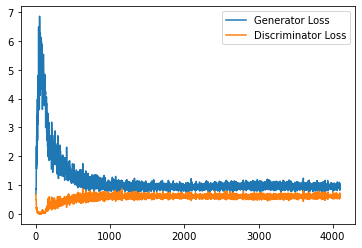

Step 82500: Generator loss: 0.9304475169181824, discriminator loss: 0.624221639573574


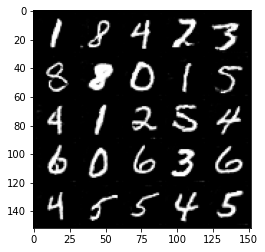

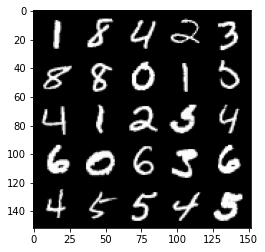

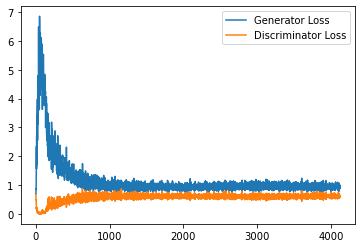

Step 83000: Generator loss: 0.931718110203743, discriminator loss: 0.6240120880007743


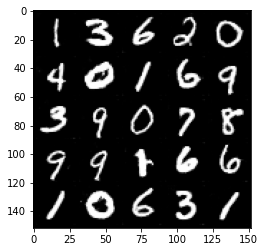

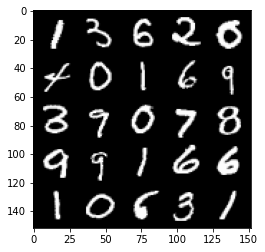

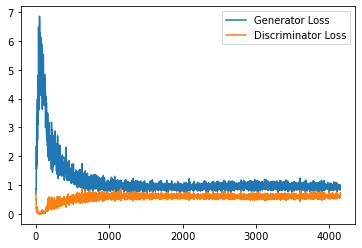

Step 83500: Generator loss: 0.9331048004627228, discriminator loss: 0.6227577181458473


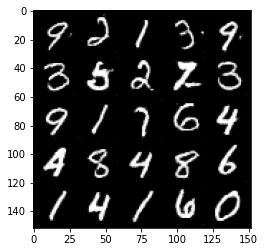

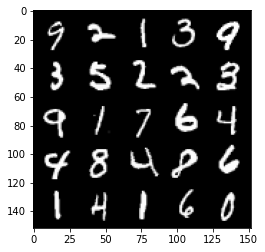

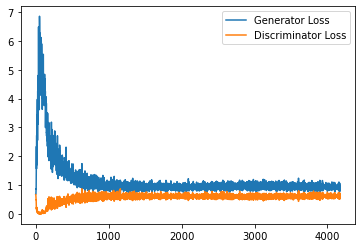

Step 84000: Generator loss: 0.9424045190811158, discriminator loss: 0.6232860429286957


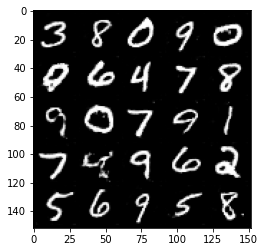

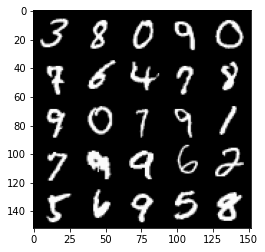

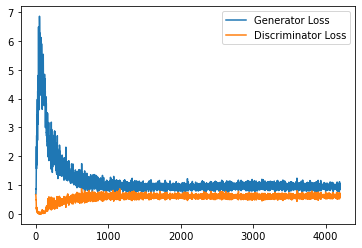

Step 84500: Generator loss: 0.9249260922670365, discriminator loss: 0.6234211941361427


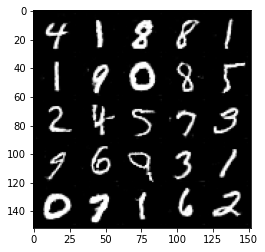

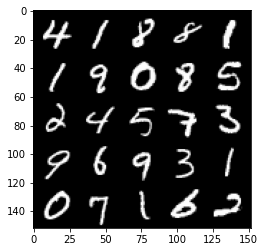

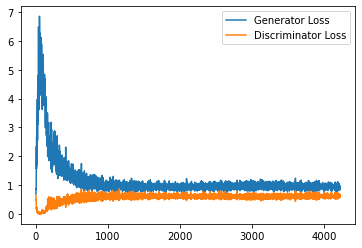

Step 85000: Generator loss: 0.9389371045827866, discriminator loss: 0.6215943657755851


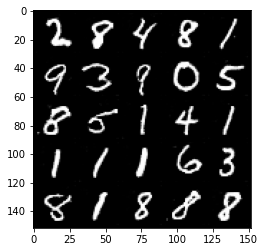

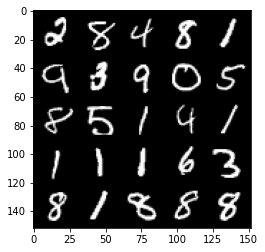

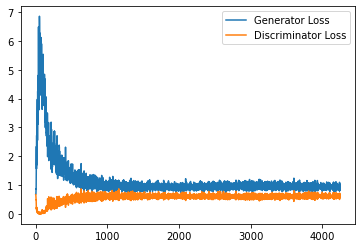

Step 85500: Generator loss: 0.9438758877515793, discriminator loss: 0.6249192708134651


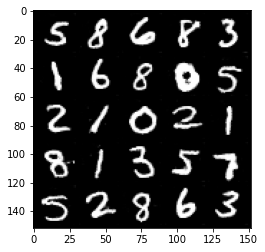

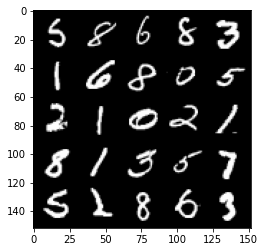

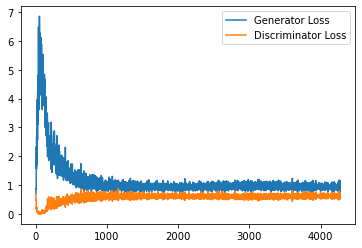

Step 86000: Generator loss: 0.9228770916461945, discriminator loss: 0.6274252690672875


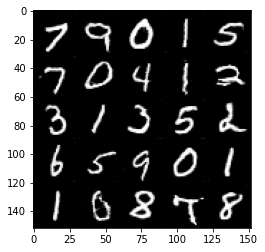

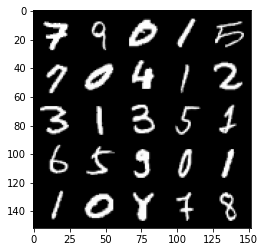

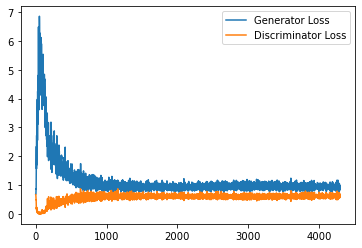

Step 86500: Generator loss: 0.927799973487854, discriminator loss: 0.6236366444230079


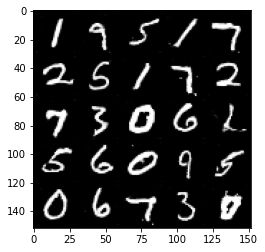

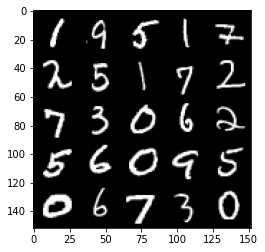

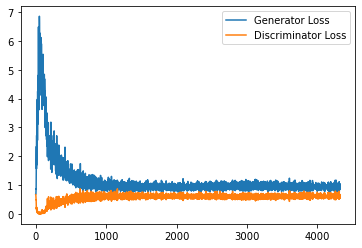

Step 87000: Generator loss: 0.9174097825288773, discriminator loss: 0.6333150566220284


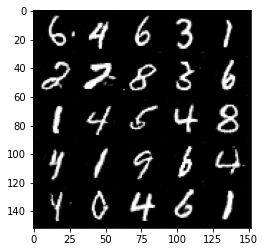

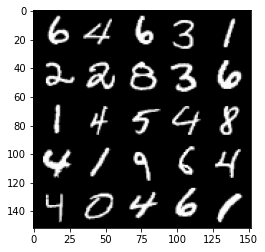

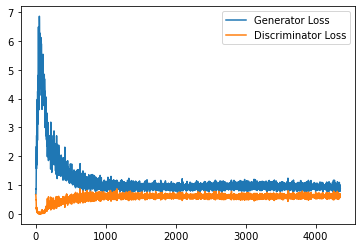

Step 87500: Generator loss: 0.9336219147443772, discriminator loss: 0.6250818944573402


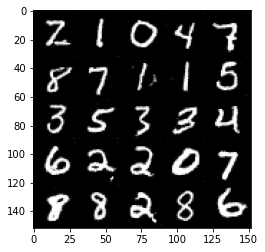

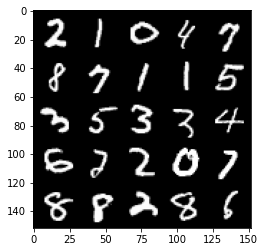

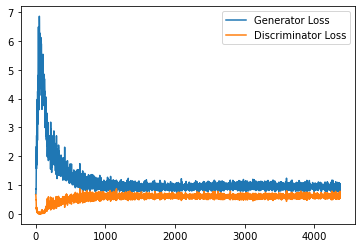

Step 88000: Generator loss: 0.9390165998935699, discriminator loss: 0.6273247324824334


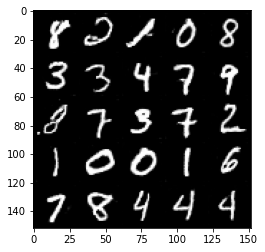

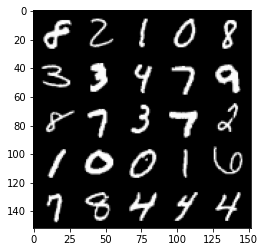

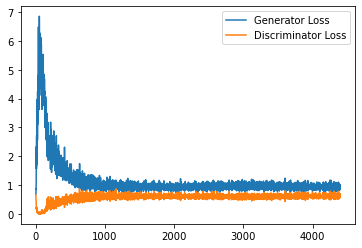

Step 88500: Generator loss: 0.9256344602108002, discriminator loss: 0.6346381813883781


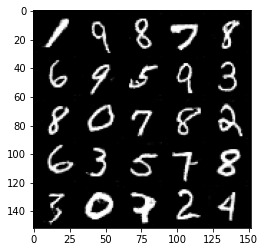

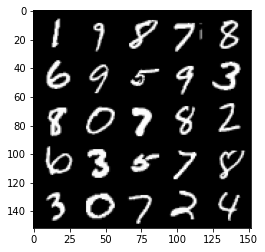

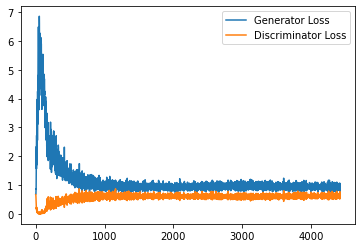

Step 89000: Generator loss: 0.8974504872560501, discriminator loss: 0.6367540647387504


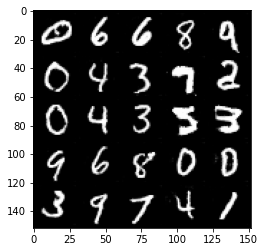

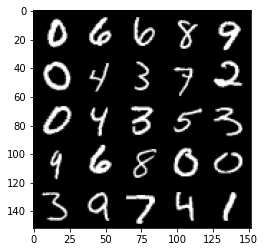

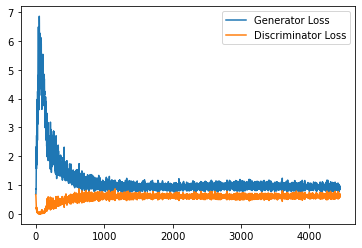

Step 89500: Generator loss: 0.9290111901760101, discriminator loss: 0.6285379335284234


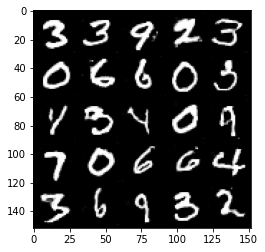

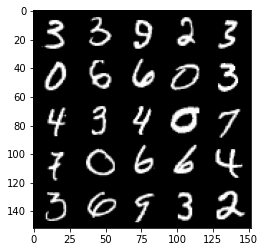

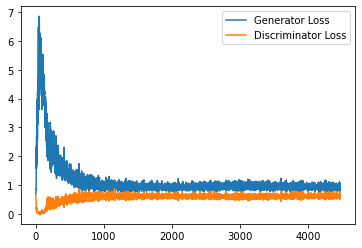

Step 90000: Generator loss: 0.9110908753871918, discriminator loss: 0.6354756188988686


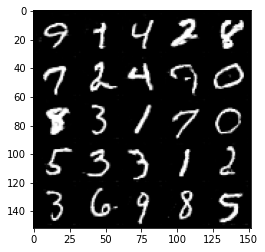

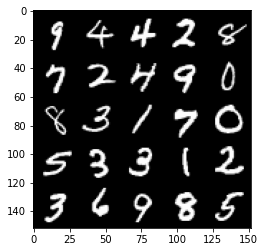

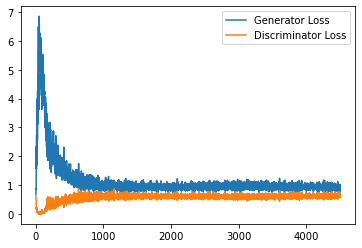

Step 90500: Generator loss: 0.9239203243255615, discriminator loss: 0.6251542870402336


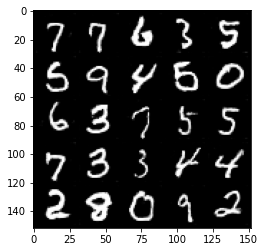

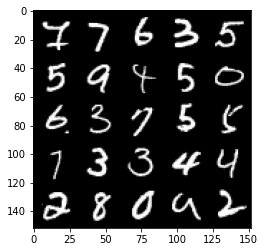

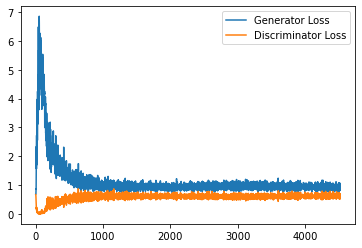

Step 91000: Generator loss: 0.9174616346359253, discriminator loss: 0.6313379990458489


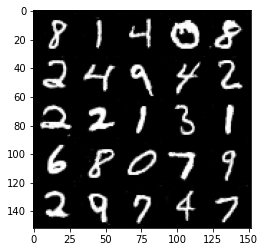

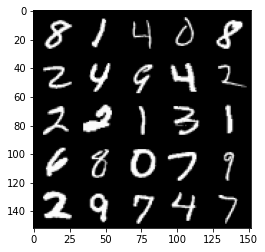

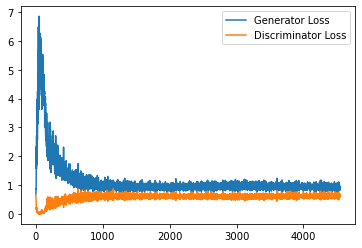

Step 91500: Generator loss: 0.9149944560527802, discriminator loss: 0.6324696710109711


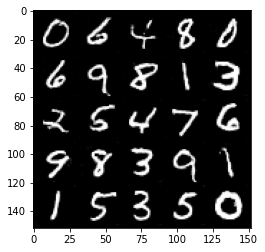

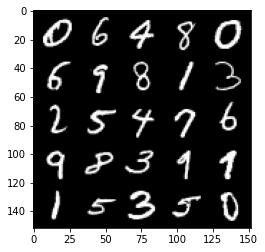

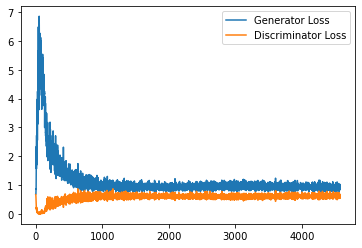

Step 92000: Generator loss: 0.9126956925392151, discriminator loss: 0.6372716864943504


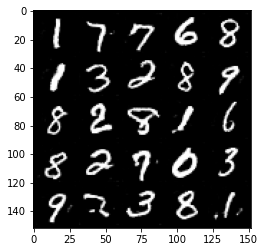

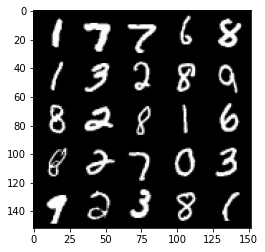

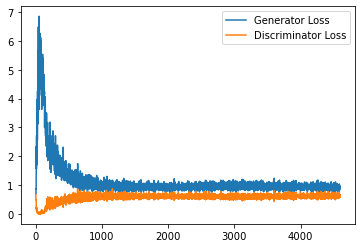

Step 92500: Generator loss: 0.9366031218767166, discriminator loss: 0.6267476723194122


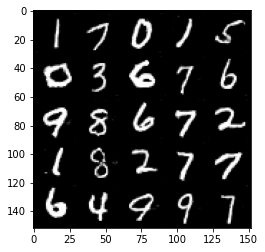

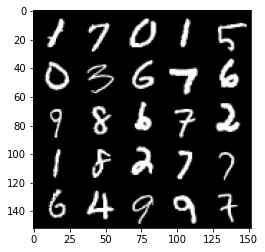

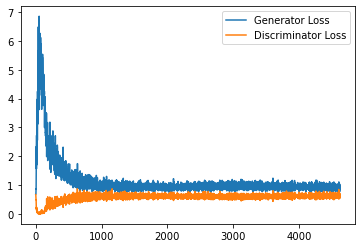

Step 93000: Generator loss: 0.9073504127264023, discriminator loss: 0.6377873730063438


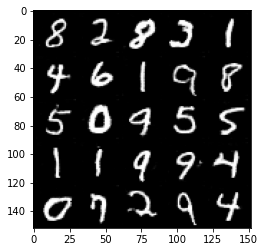

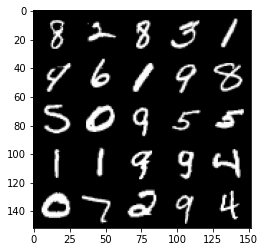

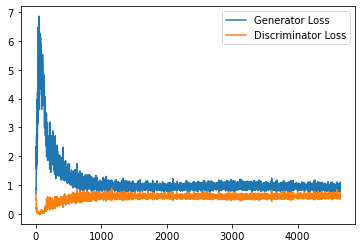

Step 93500: Generator loss: 0.9202766799926758, discriminator loss: 0.6283736400008202


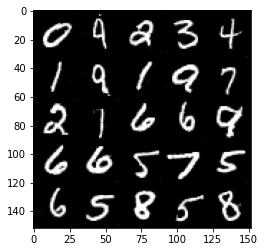

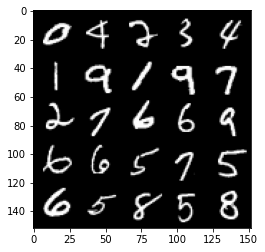

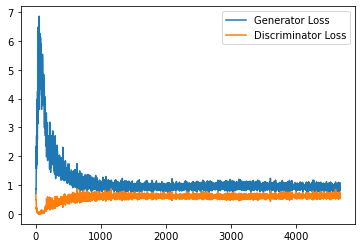

In [33]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels.float())
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels.float())
        real_image_and_labels = combine_vectors(real, image_one_hot_labels.float())
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)

        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [34]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

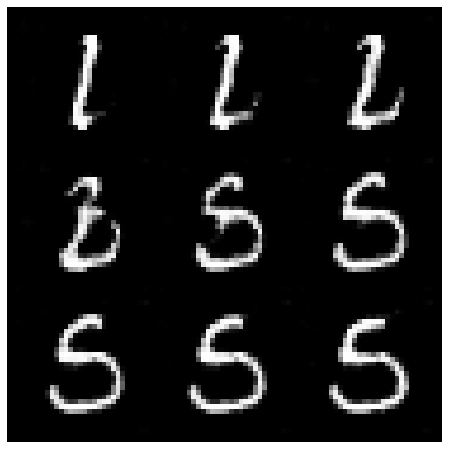

In [38]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

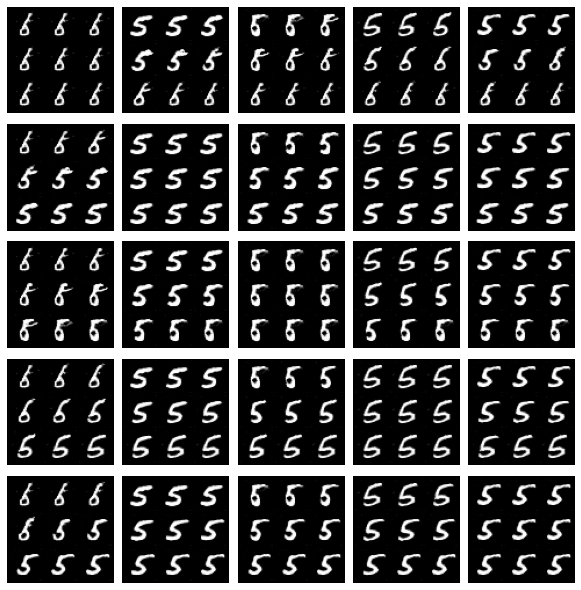

In [39]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()